<a href="https://colab.research.google.com/github/afiliot/Bayesian-Personalization-of-a-Tumor-Growth-Model/blob/master/Medical_Image_Analysis_Project_MVA.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Medical Imaging Project - MVA MSc - Implementation of Diffusion-Reaction model applied to glioma growth.

In this project, we implement Lattice Boltzmann Method and Crank Nicholson scheme to simulate the growth of a particlarly infiltrative tumor : grade IV gliomas, also called glioblastomas mutliformes (GBM). This implementation is based on the article "MRI Based Bayesian Personalization of a Tumor Growth Model", from Lê et al. (2016). We use the MNI atlas to apply our growth model to real MRI. The equation under scrutiny is the so called FKPP (Fisher, Kolmogorov, Petrovsky, Piscounov) equation: $$\frac{\partial u}{\partial t} = \nabla(D.\nabla u) + \rho u (1-u)$$
with $$D\nabla u \cdot n_{\partial \Omega} = 0$$ which describes an anisotropic diffusion with a logistic proliferation term. 
$$D = d_w I_{3\times3}$$ in white matter and 
$$D = \frac{d_w}{10} I_{3\times3} = d_g I_{3\times3}$$  to account for the fact that it is clinically admitted that tumor cells have higher motility in white matter, compared to gray matter.

## Importing the data

First, we download some of the images available from the MNI atlas.

In [94]:
!wget http://www.bic.mni.mcgill.ca/~vfonov/icbm/2009/mni_icbm152_nlin_sym_09a_minc2.zip
!unzip mni_icbm152_nlin_sym_09a_minc2.zip

--2019-03-16 10:35:05--  http://www.bic.mni.mcgill.ca/~vfonov/icbm/2009/mni_icbm152_nlin_sym_09a_minc2.zip
Resolving www.bic.mni.mcgill.ca (www.bic.mni.mcgill.ca)... 132.206.178.156
Connecting to www.bic.mni.mcgill.ca (www.bic.mni.mcgill.ca)|132.206.178.156|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 75746008 (72M) [application/zip]
Saving to: ‘mni_icbm152_nlin_sym_09a_minc2.zip.1’

mni_icbm152_nlin_sy 100%[===================>]  72.24M  20.5MB/s    in 4.0s    

2019-03-16 10:35:09 (17.9 MB/s) - ‘mni_icbm152_nlin_sym_09a_minc2.zip.1’ saved [75746008/75746008]

Archive:  mni_icbm152_nlin_sym_09a_minc2.zip
replace mni_icbm152_t1_tal_nlin_sym_09a.mnc? [y]es, [n]o, [A]ll, [N]one, [r]ename: N


Then, mount our respective drives in order to save and use files directly from them.

In [95]:
from google.colab import drive
drive.mount('/content/gdrive')

Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).


## Packages

In [0]:
# graphs
import matplotlib.cm as cm
import matplotlib.pyplot as plt
# videos
import cv2
# basic libraries
import os
import numpy as np
from copy import deepcopy
from tqdm import tqdm as tqdm
import time
import gc
# optimization
import scipy.linalg
from scipy.sparse import csc_matrix
from scipy.sparse.linalg import spsolve
from scipy.stats import linregress
# load and dump data
import pickle as pkl
import warnings
# remove warnings
warnings.filterwarnings('ignore')

## Utils function

In [0]:
def geo_mean(iterable):
  """
  Compute geometric mean of an array
  """
    a = np.array(iterable)
    return a.prod()**(1.0/len(a))
  
def read_mnc(path, file):
  """
  Read an image from the MNI atlas
  """
  img = nib.load(os.path.join(path, file))
  data = img.get_fdata()
  return data

## Display IRM from MNI atlas

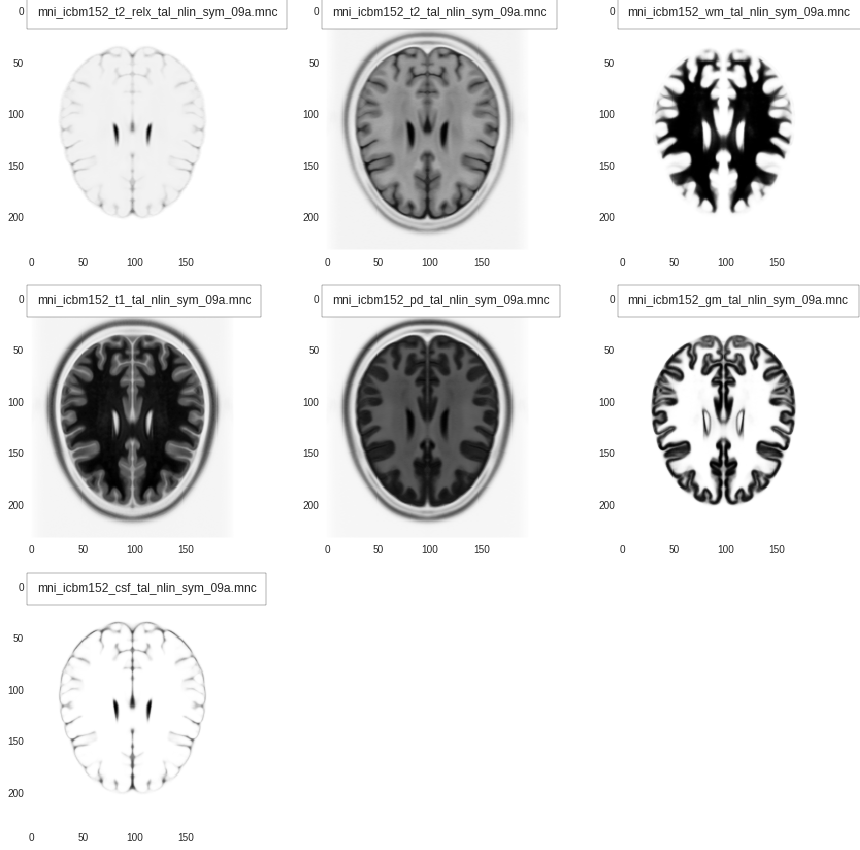

In [3]:
path = '/content'
files = ['mni_icbm152_t2_relx_tal_nlin_sym_09a.mnc',
         'mni_icbm152_t2_tal_nlin_sym_09a.mnc',
         'mni_icbm152_wm_tal_nlin_sym_09a.mnc',
         'mni_icbm152_t1_tal_nlin_sym_09a.mnc',
         'mni_icbm152_pd_tal_nlin_sym_09a.mnc',
         'mni_icbm152_gm_tal_nlin_sym_09a.mnc',
         'mni_icbm152_csf_tal_nlin_sym_09a.mnc']
f, ax = plt.subplots(3, 3, figsize=(15,15))
for i, file in enumerate(files):
  k, l = i//3, i%3
  data = read_mnc(path, file)
  ax[k, l].imshow(data[100])
  ax[k, l].grid(False)
  ax[k, l].text(5, 5, file, bbox={'facecolor': 'white', 'pad': 10})
ax[-1, -2].axis('off')  
ax[-1, -1].axis('off')
f.show()

## Normalize IRM into 3 modes of intensities

1 for white matter, 0 for csf, 0.5 for gray matter.

In [0]:
white_matter = 'mni_icbm152_wm_tal_nlin_sym_09a.mnc'
grey_matter = 'mni_icbm152_gm_tal_nlin_sym_09a.mnc'
csf = 'mni_icbm152_csf_tal_nlin_sym_09a.mnc'
outside_lim = 'mni_icbm152_t2_relx_tal_nlin_sym_09a.mnc'

img = read_mnc(path, 'mni_icbm152_t1_tal_nlin_sym_09a.mnc')
wm = read_mnc(path, white_matter)
gm = read_mnc(path, grey_matter)
csf = read_mnc(path, csf)
out = read_mnc(path, outside_lim)

  
def normalize_frame(i, img = img):
  img_norm = img[i].copy()
  zero_index = np.where(img_norm < 30)
  img_norm[zero_index] = 0
  img_norm = (img_norm - np.min(img_norm))/(np.max(img_norm)-np.min(img_norm))
  out_index = np.where(out[i] < 0.08)
  csf_index = np.where(csf[i] > 0.15)
  wm_index = np.where(wm[i] > 0.5)
  img_norm[out_index], img_norm[csf_index], img_norm[wm_index] = 0, 0, 1
  gm_index = np.where(np.logical_and(img_norm > 0, img_norm < 1))
  img_norm[gm_index] = 0.5
  return img_norm

def normalize_IRM(img=img):
  new_img = img.copy()
  for i in range(img.shape[0]):
    new_img[i] = normalize_frame(i, img)
  return new_img

def compare_with_norm(i, img = img):
  f, ax = plt.subplots(1, 2,figsize=(10,5))
  ax[0].imshow(1-img[i], label='Before normalization')
  ax[0].grid(False)
  ax[0].text(5, 5, 'Raw image '+str(i), bbox={'facecolor': 'white', 'pad': 10})
  img_norm = normalize_frame(i, img)
  ax[1].imshow(1-img_norm, label='After normalization')
  ax[1].text(5, 5, 'Binary image '+str(i), bbox={'facecolor': 'white', 'pad': 10})
  ax[1].grid(False)
  f.show()

Compare before and after binarization.

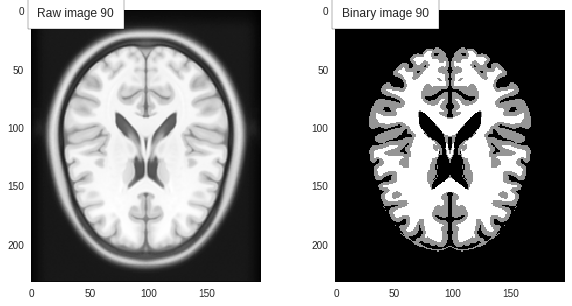

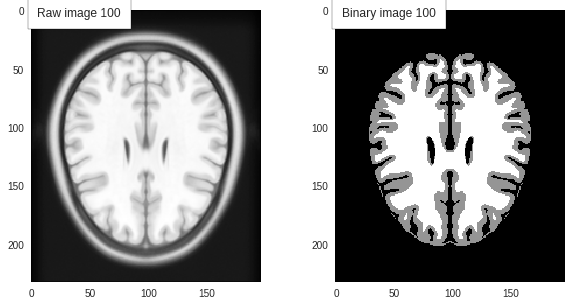

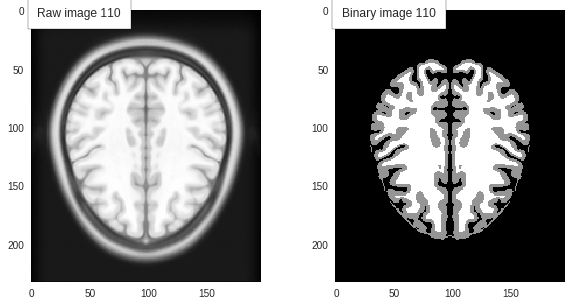

In [89]:
compare_with_norm(90)
compare_with_norm(100)
compare_with_norm(110)

## Make 3D IRM videos 

In [0]:
def make_3D_video(title, norm=False, file='mni_icbm152_t1_tal_nlin_sym_09a.mnc'):
  warnings.filterwarnings('ignore')
  img = read_mnc(path, file).astype(float)
  height, width = img[0].shape
  fourcc = cv2.VideoWriter_fourcc('M','J','P','G')
  fps = 10
  video_filename = title+'.mp4'
  out = cv2.VideoWriter(video_filename, fourcc, fps, (width, height))
  for i in tqdm(range(img.shape[0])):
    if norm:
      gray = cv2.normalize(normalize_frame(i, img), None, 255, 0, norm_type=cv2.NORM_MINMAX, dtype=cv2.CV_8U)
    else:
      gray = cv2.normalize(img[i], None, 255, 0, norm_type=cv2.NORM_MINMAX, dtype=cv2.CV_8U)
    out.write(cv2.merge([gray, gray, gray]))
  out.release()
  warnings.filterwarnings('always')

The videos ``brain.mp4`` and ``brain_norm.mp4`` will be saved in your local virtual environment. 

In [93]:
make_3D_video('brain')
make_3D_video('brain_norm', norm=True)

100%|██████████| 189/189 [00:00<00:00, 196.18it/s]


## Lattice Boltzmann Method on 3D IRM

In [0]:
IRM_b = normalize_IRM(img)

class LBM_IRM():
  def __init__(self, IRM=IRM_b, x0=[100, 95, 127], a=1, b=30, L0=10, tau_1=0.8, tau_2=0.16, d_w=1, rho=0.18, dx=1, dt=0.1):
    self.d_w = d_w
    self.D_w = d_w * np.eye(3)
    self.D_g = d_w / 10 * np.eye(3)
    self.rho = rho
    self.dx = dx
    self.dt = dt
    self.e = np.array([[0, 1, -1, 0, 0, 0, 0],
                       [0, 0, 0, 1, -1, 0, 0],
                       [0, 0, 0, 0, 0, 1, -1]])
    self.w = np.array([0.25, 0.125,  0.125,  0.125,  0.125,  0.125,  0.125])
    self.M = np.array([[1, 1, 1, 1, 1, 1, 1],
                      [0, 1, -1, 0, 0, 0, 0],
                      [0, 0, 0, 1, -1, 0, 0],
                      [0, 0, 0, 0, 0, 1, -1],
                      [6, -1, -1, -1, -1, -1, -1],
                      [0, 2, 2, -1, -1, -1, -1],
                      [0, 0, 0, 1, 1, -1, -1]])
    self.S_inv_w = np.array([[1.33, 0, 0, 0, 0, 0, 0],
                          [0, self.tau(0, 0), self.tau(0, 1), self.tau(0, 2), 0, 0, 0],
                          [0, self.tau(1, 0), self.tau(1, 1), self.tau(1, 2), 0, 0, 0],
                          [0, self.tau(2, 0), self.tau(2, 1), self.tau(2, 2), 0, 0, 0],
                          [0, 0, 0, 0, 1.33, 0, 0],
                          [0, 0, 0, 0, 0, 1.33, 0],
                          [0, 0, 0, 0, 0, 0, 1.33]])
    self.S_inv_g = np.array([[1.33, 0, 0, 0, 0, 0, 0],
                          [0, self.tau(0, 0, False), self.tau(0, 1, False), self.tau(0, 2, False), 0, 0, 0],
                          [0, self.tau(1, 0, False), self.tau(1, 1, False), self.tau(1, 2, False), 0, 0, 0],
                          [0, self.tau(2, 0, False), self.tau(2, 1, False), self.tau(2, 2, False), 0, 0, 0],
                          [0, 0, 0, 0, 1.33, 0, 0],
                          [0, 0, 0, 0, 0, 1.33, 0],
                          [0, 0, 0, 0, 0, 0, 1.33]])
    self.A_w = np.dot(np.linalg.inv(self.M), np.linalg.inv(self.S_inv_w)).dot(self.M)
    self.A_g = np.dot(np.linalg.inv(self.M), np.linalg.inv(self.S_inv_g)).dot(self.M)
    self.A_w[self.A_w < 1e-5] = 0
    self.A_w[self.A_g < 1e-5] = 0
    self.IRM = IRM
    self.domain = IRM.flatten()
    self.n = self.domain.shape[0]
    self.nz, self.ny, self.nx = self.IRM.shape           
    self.x0 = x0
    self.a = a
    self.b = b  
    self.L0 = L0
    print('Initialization...')
    self.u0 = self.init()   
    self.u = self.u0.flatten().reshape((1, self.n))
    self.u_alpha = (self.w * np.repeat(self.u, 7, axis=0).T).T
        
    
  def tau(self, i, j, white_matter=True):
    if white_matter:
      return 0.5 * (i==j) + 4 * self.dt / (self.dx**2) * self.D_w[i, j]
    else:
      return 0.5 * (i==j) + 4 * self.dt / (self.dx**2) * self.D_g[i, j]
         
  def init(self):
      u = np.zeros((self.nz, self.ny, self.nx)) 
      for i in range(-self.L0, self.L0):
          for j in range(-self.L0, self.L0):
              for k in range(-self.L0, self.L0):
                  u[self.x0[0] + k, self.x0[1] + j, self.x0[2] + i] = self.a * np.exp(-np.linalg.norm(np.array([i, j, k]), 2)**2 / self.b)
      gc.collect()
      return u
    
  def discretize_r(self, u):
    u = np.zeros((self.nz, self.ny, self.nx))
    for k in range(0, self.nz):
      for j in range(0, self.ny):
        for i in range(0, self.nx):
          u[k, j, i] = self.u[:, k*(self.nx * self.ny) + j*self.nx + i]
    return u

  def collision(self, u_alpha):
    u_alpha_star = deepcopy(u_alpha)
    for i in range(self.n):
      if self.domain[i] == 0.5: #grey matter
        u_alpha_star[:, i] += self.dt * self.w * self.rho * self.u[:, i] * (1 - self.u[:, i]) - np.dot(self.A_g, u_alpha[:, i])
      elif self.domain[i] == 1: #white matter
        u_alpha_star[:, i] += self.dt * self.w * self.rho * self.u[:, i] * (1 - self.u[:, i]) - np.dot(self.A_w, u_alpha[:, i])
      else:
        u_alpha_star[:, i] = np.zeros(7)
    gc.collect()
    return u_alpha_star
          
  def streaming(self, u_alpha, u_alpha_star):
    for i in range(self.n):
      if self.domain[i] == 0:
        u_alpha[:, i] = np.zeros(7)
      else:
        u_i_star = u_alpha_star[:, i]
        for alpha in range(7):
          if alpha == 0: # x 
            u_alpha[:, i] = u_i_star
          elif alpha == 1: # x + 1
            if i+1 < self.n:
              u_alpha[:, i+1] = u_i_star
          elif alpha == 2: # x - 1
            if i - 1 >= 0:
              u_alpha[:, i-1] = u_i_star
          elif alpha == 3: # y + 1
            if i + self.nx < self.n:
              u_alpha[:, i + self.nx] = u_i_star
          elif alpha == 4: # y - 1
            if i - self.nx >= 0:
              u_alpha[:, i - self.nx] = u_i_star      
          elif alpha == 5: # z + 1
            if i + self.nx * self.ny < self.n:
              u_alpha[:, i + self.nx * self.ny] = u_i_star
          elif alpha == 6: # z - 1
            if i + self.nx * self.ny >= 0:
              u_alpha[:, i - self.nx * self.ny] = u_i_star
    gc.collect()
    return u_alpha
            
  def boundary_conditions(self, u_alpha):
    m = self.u.min()
    for i in range(self.n):
      if self.u[:, i] > m:
        if self.domain[i] == 0: # csf
          delta = self.delta(i)
          w1, w2 = 1/(2*delta), 1-1/(2*delta)
          for alpha in range(7):
            if alpha == 1: # x + 1
              if i+1 < self.n:
                 u_alpha[alpha][i] = w1 * u_alpha[alpha][i] + w2 * u_alpha[alpha+1][i]
            elif alpha == 2: # x - 1
              if i - 1 >= 0:
                u_alpha[alpha][i] = w1 * u_alpha[alpha][i] + w2 * u_alpha[alpha-1][i]
            elif alpha == 3: # y + 1
              if i + self.nx < self.n:
                u_alpha[alpha][i] = w1 * u_alpha[alpha][i] + w2 * u_alpha[alpha+1][i]
            elif alpha == 4: # y - 1
              if i - self.nx >= 0:
                u_alpha[alpha][i] = w1 * u_alpha[alpha][i] + w2 * u_alpha[alpha-1][i] 
            elif alpha == 5: # z + 1
              if i + self.nx * self.ny < self.n:
                u_alpha[alpha][i] = w1 * u_alpha[alpha][i] + w2 * u_alpha[alpha+1][i]
            elif alpha == 6: # z - 1
              if i + self.nx * self.ny >= 0:
                u_alpha[alpha][i] = w1 * u_alpha[alpha][i] + w2 * u_alpha[alpha-1][i]
    gc.collect()
    return u_alpha
          
  
  def coord(self, i):
    z, r = i // (self.nx * self.ny), i % (self.nx * self.ny)
    y, x = r // self.nx, r % self.nx
    return np.array([x, y, z])
  
  def find_wall(self, i):
    k = 0
    up, down = self.domain[i+k], self.domain[i-k]
    while up == 0 and down == 0:
      k += 1
      if i+k >= self.n:
        up = 0
      else:
        up = self.domain[i+k]
      if i-k < 0:
        down = 0
      else:
        down = self.domain[i-k]
    if up > 0:
      return self.coord(i+k)
    elif down > 0:
      return self.coord(i-k)
      
  def delta(self, i):
    return np.linalg.norm(self.coord(i)-self.find_wall(i), ord=2)
  
  def normalize(self, x):
    return (x-x.min()) / (x.max()-x.min())
  
  def simulation(self, T):
    self.u = self.u0.flatten().reshape((1, self.n))
    self.u_alpha = (self.w * np.repeat(self.u, 7, axis=0).T).T
    for t in range(int(T/self.dt)):
      time_ = time.time()
      print('Day {:3.1f}'.format(self.dt * (t+1)))
      print('...Collision...')
      self.u_alpha_star = self.collision(self.u_alpha)
      gc.collect()
      print('...Streaming...')
      self.u_alpha = self.streaming(self.u_alpha, self.u_alpha_star)
      gc.collect()
      #print('...Neumann boundary conditions...')
      #self.u_alpha = self.boundary_conditions(self.u_alpha)
      gc.collect()
      self.u = np.sum(self.u_alpha, axis=0).reshape((1, self.n))  
      print(self.u.max(), self.u.min())
      #print('...Normalizing...')
      #self.u = self.normalize(self.u)
      #for alpha in range(7):
      #  self.u_alpha[alpha] = self.normalize(self.u_alpha[alpha]) * self.w[alpha]
      gc.collect()
      print('Time elapsed: {:5.0f} sec.\n'.format(time.time()-time_))
    print('Reshape...')
    self.u = self.discretize_r(self.u)

Initialize LBM instance.

In [26]:
lbm = LBM_IRM(d_w=15, rho=1)

Initialization...


Run a simulation with a particular time horizon $T$.

In [27]:
lbm.simulation(T=0.5)

Day 0.1
...Collision...
...Streaming...
0.4723828802776171 0.0
Time elapsed:    57 sec.

Day 0.2
...Collision...
...Streaming...
0.2648338832410474 0.0
Time elapsed:    57 sec.

Day 0.3
...Collision...
...Streaming...
0.15790482879328732 0.0
Time elapsed:    57 sec.

Day 0.4
...Collision...
...Streaming...
0.09663306296159566 0.0
Time elapsed:    58 sec.

Day 0.5
...Collision...
...Streaming...
0.05984787755752558 0.0
Time elapsed:    57 sec.

Reshape...


Vizualize the tumor.

In [0]:
  def viz(u, vmin=0, vmax=1, z=100, figsize=(5,5)):
      im = IRM_b[z]
      fig, ax = plt.subplots(figsize=figsize)
      u_ = (u[z] - u[z].min()) / (u[z].max() - u[z].min())
      u_[np.where(u_ == u_[0, 0])] = 0
      v1b = np.ma.masked_array(u_, u_<0.01)
      tumor = v1b * u_
      pa = ax.imshow(1-im, interpolation='nearest',cmap=cm.Greys)
      pb = ax.imshow(tumor, interpolation='bicubic',cmap=cm.Reds)
      #cbb = plt.colorbar(pb,shrink=0.25)
      ax.grid(False)
      ax.axis('off')

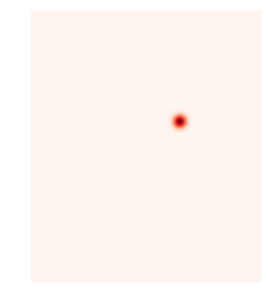

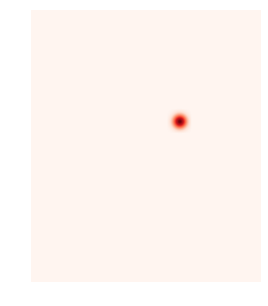

In [33]:
viz(lbm.u0, z=100, vmin=0, vmax=1)
viz(lbm.u, z=100, vmin=0.0, vmax=1)

## LBM on 3D cube

In [0]:
class LBM_cube():
  def __init__(self, b=30, nx=100, ny=100, nz=100, pad=1, L0=10, tau_1=0.8, tau_2=0.16, d_w=1, rho=0.18, dx=1, dt=0.1):
    self.d_w = d_w
    self.D = d_w * np.eye(3)
    self.rho = rho
    self.dx = dx
    self.dt = dt
    self.e = np.array([[0, 1, -1, 0, 0, 0, 0],
                       [0, 0, 0, 1, -1, 0, 0],
                       [0, 0, 0, 0, 0, 1, -1]])
    self.w = np.array([0.25, 0.125,  0.125,  0.125,  0.125,  0.125,  0.125])
    self.M = np.array([[1, 1, 1, 1, 1, 1, 1],
                      [0, 1, -1, 0, 0, 0, 0],
                      [0, 0, 0, 1, -1, 0, 0],
                      [0, 0, 0, 0, 0, 1, -1],
                      [6, -1, -1, -1, -1, -1, -1],
                      [0, 2, 2, -1, -1, -1, -1],
                      [0, 0, 0, 1, 1, -1, -1]])
    self.S_inv = np.array([[1.33, 0, 0, 0, 0, 0, 0],
                          [0, self.tau(0, 0), self.tau(0, 1), self.tau(0, 2), 0, 0, 0],
                          [0, self.tau(1, 0), self.tau(1, 1), self.tau(1, 2), 0, 0, 0],
                          [0, self.tau(2, 0), self.tau(2, 1), self.tau(2, 2), 0, 0, 0],
                          [0, 0, 0, 0, 1.33, 0, 0],
                          [0, 0, 0, 0, 0, 1.33, 0],
                          [0, 0, 0, 0, 0, 0, 1.33]])
    self.A = np.dot(np.linalg.inv(self.M), np.linalg.inv(self.S_inv)).dot(self.M)
    self.A[self.A < 1e-5] = 0
    self.nx = nx
    self.ny = ny
    self.nz = nz
    self.pad = pad
    self.domain_0 = np.ones((self.nz, self.ny, self.nx))
    for i in range(self.nz):
      self.domain_0[i] = np.pad(np.ones((self.nx-2*self.pad, self.ny-2*self.pad)), pad_width=pad, mode='constant', constant_values=0)
    self.domain = self.domain_0.flatten()
    self.n = self.domain.shape[0]       
    self.x0 = [self.nz//2, self.ny//2, self.nx//2]
    self.b = b  
    self.L0 = L0
    print('Initialization...')
    self.u0 = self.init()
    self.u = self.u0.flatten().reshape((1, self.n))
    self.u_alpha = (self.w * np.repeat(self.u, 7, axis=0).T).T
    
  def tau(self, i, j):
    return 0.5 * (i==j) + 4 * self.dt / (self.dx**2) * self.D[i, j]
         
  def init(self):
      u = np.zeros((self.nz, self.ny, self.nx)) 
      for i in range(-self.L0, self.L0):
          for j in range(-self.L0, self.L0):
              for k in range(-self.L0, self.L0):
                  u[self.x0[0] + k, self.x0[1] + j, self.x0[2] + i] = np.exp(-np.linalg.norm(np.array([i, j, k]), 2)**2 / self.b)
      gc.collect()
      return u

  
  def discretize_r(self, u):
    u = np.zeros((self.nz, self.ny, self.nx))
    for k in range(0, self.nz):
      for j in range(0, self.ny):
        for i in range(0, self.nx):
          u[k, j, i] = self.u[:, k*(self.nx * self.ny) + j*self.nx + i]
    return u

  def collision(self, u_alpha):
    u_alpha_star = deepcopy(u_alpha)
    for i in range(self.n):
       if self.domain[i] == 1: #white matter
          u_alpha_star[:, i] += self.dt * self.w * self.rho * self.u[:, i] * (1 - self.u[:, i]) - np.dot(self.A, u_alpha[:, i])
          if i == self.nx * self.ny * self.nz//2 + self.nx * self.ny//2 + self.nx//2:
            print(self.dt * self.w * self.rho * self.u[:, i] * (1 - self.u[:, i]))
            print( - np.dot(self.A, u_alpha[:, i]))
    gc.collect()
    return u_alpha_star
  
          
  def streaming(self, u_alpha, u_alpha_star):
    for alpha in range(7):
      for i in range(self.n):
        u_i_star = u_alpha_star[alpha][i]
        if alpha == 0: # x 
          u_alpha[alpha][i] = u_i_star
        elif alpha == 1: # x + 1
          if i+1 < self.n:
            u_alpha[alpha][i+1] = u_i_star
        elif alpha == 2: # x - 1
          if i - 1 >= 0:
            u_alpha[alpha][i-1] = u_i_star
        elif alpha == 3: # y + 1
          if i + self.nx < self.n:
            u_alpha[alpha][i + self.nx] = u_i_star
        elif alpha == 4: # y - 1
          if i - self.nx >= 0:
            u_alpha[alpha][i - self.nx] = u_i_star      
        elif alpha == 5: # z + 1
          if i + self.nx * self.ny < self.n:
            u_alpha[alpha][i + self.nx * self.ny] = u_i_star
        elif alpha == 6: # z - 1
          if i + self.nx * self.ny >= 0:
            u_alpha[alpha][i - self.nx * self.ny] = u_i_star
    gc.collect()
    return u_alpha
            
  def boundary_conditions(self, u_alpha):
    for alpha in range(7):
      for i in range(self.n):
        if self.domain[i] == 0 and self.u[:, i] > 0: # csf
          delta = self.delta(i)
          w1, w2 = 1/(2*delta), 1-1/(2*delta)
          if alpha == 1: # x + 1
            if i+1 < self.n:
              u_alpha[alpha][i] = w1 * u_alpha[alpha][i] + w2 * u_alpha[alpha+1][i]
          elif alpha == 2: # x - 1
            if i - 1 >= 0:
              u_alpha[alpha][i] = w1 * u_alpha[alpha][i] + w2 * u_alpha[alpha-1][i]
          elif alpha == 3: # y + 1
            if i + self.nx < self.n:
              u_alpha[alpha][i] = w1 * u_alpha[alpha][i] + w2 * u_alpha[alpha+1][i]
          elif alpha == 4: # y - 1
            if i - self.nx >= 0:
              u_alpha[alpha][i] = w1 * u_alpha[alpha][i] + w2 * u_alpha[alpha-1][i] 
          elif alpha == 5: # z + 1
            if i + self.nx * self.ny < self.n:
              u_alpha[alpha][i] = w1 * u_alpha[alpha][i] + w2 * u_alpha[alpha+1][i]
          elif alpha == 6: # z - 1
            if i + self.nx * self.ny >= 0:
              u_alpha[alpha][i] = w1 * u_alpha[alpha][i] + w2 * u_alpha[alpha-1][i]
    gc.collect()
    return u_alpha
          
  
  def coord(self, i):
    z, r = i // (self.nx * self.ny), i % (self.nx * self.ny)
    y, x = r // self.nx, r % self.nx
    return np.array([x, y, z])
  
  def find_wall(self, i):
    k = 0
    up, down = self.domain[i+k], self.domain[i-k]
    while up == 0 and down == 0:
      k += 1
      if i+k >= self.n:
        up = 0
      else:
        up = self.domain[i+k]
      if i-k < 0:
        down = 0
      else:
        down = self.domain[i-k]
    if up > 0:
      return self.coord(i+k)
    elif down > 0:
      return self.coord(i-k)
      
  def delta(self, i):
    return np.linalg.norm(self.coord(i)-self.find_wall(i), ord=2)
  
  def normalize(self, x):
    return (x-x.min()) / (x.max()-x.min())
  
  
  def simulation(self, T):
    self.u = self.u0.flatten().reshape((1, self.n))
    self.u_alpha = (self.w * np.repeat(self.u, 7, axis=0).T).T
    print(self.u[:, [0, self.nx * self.ny * self.nz//2 + self.nx * self.ny//2 + self.nx//2]])
    print(self.u_alpha[:, [0, self.nx * self.ny * self.nz//2 + self.nx * self.ny//2 + self.nx//2]])
    for t in range(int(T/self.dt)):
      time_ = time.time()
      print('Day {:3.1f}'.format(self.dt * (t+1)))
      print('...Collision...')
      self.u_alpha_star = self.collision(self.u_alpha)
      print(self.u_alpha_star[:, [0, self.nx * self.ny * self.nz//2 + self.nx * self.ny//2 + self.nx//2]])
      gc.collect()
      print('...Streaming...')
      self.u_alpha = self.streaming(self.u_alpha, self.u_alpha_star)
      print(self.u_alpha[:, [0, self.nx * self.ny * self.nz//2 + self.nx * self.ny//2 + self.nx//2]])
      gc.collect()
      print('...Neumann boundary conditions...')
      self.u_alpha = self.boundary_conditions(self.u_alpha)
      gc.collect()
      self.u = np.sum(self.u_alpha, axis=0).reshape((1, self.n))  
      print("Print u")
      print(self.u[:, [0, self.nx * self.ny * self.nz//2 + self.nx * self.ny//2 + self.nx//2]])
      print('Time elapsed: {:5.0f} sec.\n'.format(time.time()-time_))
    print('Reshape...')
    self.u = self.discretize_r(self.u)
    self.u = self.normalize(self.u)
    

  def viz(self, u, vmin=0, vmax=1, z=100, figsize=(5,5)):
      im = self.domain_0[z]
      fig,ax = plt.subplots(figsize=figsize)
      v1b = np.ma.masked_array(u[z], u[z]<0.01)
      pa = ax.imshow(1-im, interpolation='gaussian',cmap=cm.Greys)
      pb = ax.imshow(u[z], interpolation='gaussian',cmap=plt.get_cmap('hot'), vmin=vmin, vmax=vmax)
      #cbb = plt.colorbar(pb,shrink=0.25)
      ax.grid(False)
      ax.axis('off')

Initialize LBM instance.

In [0]:
lbm = LBM_cube(nx=50, b=1, ny=50, nz=100, L0=3, dx=1, dt=0.1, d_w=1e-3, rho=0.2)
lbm.simulation(T=1)

Initialization...


Vizualize u.

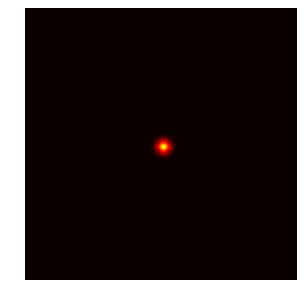

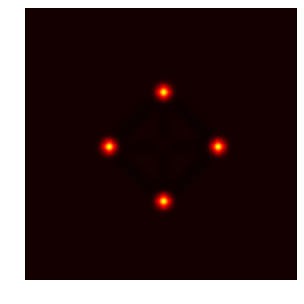

In [0]:
lbm.viz(lbm.u0, z=50, vmin=0, vmax=1)
lbm.viz(lbm.u, z=50, vmin=0, vmax=1)

## Crank Nicholson scheme on 2D square

In [0]:
class CNicholson2D():
    def __init__(self, D=0.1, rho=0.18, Lx=200, Ly=200, Nx=100, Ny=100, dt=0.1, T=200, sigma=1e-3, theta=0.5):
      self.D = D / ((Lx/Nx)**2)
      self.rho = rho
      self.Lx, self.Ly, self.Nx, self.Ny, self.N = Lx, Ly, Nx, Ny, (Nx+1)*(Ny+1)
      self.x, self.y,  = np.linspace(0, Lx, Nx+1), np.linspace(0, Ly, Ny+1)
      self.dx, self.dy = self.x[1] - self.x[0], self.y[1] - self.y[0]
      self.dt, self.T, self.Nt = dt, T, int(round(T/float(dt)))
      self.t = np.linspace(0, self.Nt*dt, self.Nt+1)
      self.theta = theta
      self.sigma = sigma
      self.Fx = self.D*self.dt/self.dx**2
      self.Fy = self.D*dt/self.dy**2
      self.A = np.zeros((self.N, self.N))
      self.b = np.zeros(self.N)
      self.u  = np.zeros((self.Nt, Nx+1, Ny+1))
      self.distances = {'geom': []}
      self.vitesses = {'t1gd':[], 't2flair': [], 'geom': []}

    def I(self, x, y):
      l = np.linalg.norm(np.array([x, y])-np.array([self.Lx//2, self.Ly//2]), 2)
      return np.exp(-l**2 / self.sigma)

    def simulation(self):
      # Initial condition
      for i in range(self.Nx+1):
          for j in range(self.Ny+1):
              self.u[0, i, j] = self.I(self.x[i], self.y[j])
              
      m = lambda i, j: j*(self.Nx+1) + i
      # Equations corresponding to j=0, i=0,1,...
      j = 0
      for i in range(self.Nx+1):
          p, self.A[p, p] = m(i,j), 1
      # Loop over all internal mesh points in y diretion
      # and all mesh points in x direction
      for j in range(1, self.Ny):
          i = 0;  p = m(i,j);  self.A[p, p] = 1           # Boundary
          for i in range(1, self.Nx):                     # Interior points
              p = m(i,j)
              self.A[p, m(i,j-1)]  = - self.theta*self.Fy
              self.A[p, m(i-1, j)] = - self.theta*self.Fx
              self.A[p, p]         = 1 + 2*self.theta*(self.Fx+self.Fy)
              self.A[p, m(i+1,j)]  = - self.theta*self.Fx
              self.A[p, m(i,j+1)]  = - self.theta*self.Fy
          i = self.Nx;  p = m(i,j);  self.A[p, p] = 1          # Boundary
      # Equations corresponding to j=Ny, i=0,1,... 
      j = self.Ny
      for i in range(self.Nx+1):
          p = m(i,j);  self.A[p, p] = 1
      # Main loop
      for t in range(self.Nt):
          # Compute b
          j = 0
          for i in range(self.Nx+1):
              p = m(i,j);  self.b[p] = 0               # Boundary
          for j in range(1, self.Ny):
              i = 0;  p = m(i,j);  self.b[p] = 0       # Boundary
              for i in range(1, self.Nx):              # Interior points
                  p = m(i,j)
                  self.b[p] = self.u[t, i, j] + (1-self.theta) * (self.Fx*(self.u[t, i+1, j] - 2*self.u[t, i, j] + self.u[t, i-1, j]) +\
                                                                 self.Fy*(self.u[t, i, j+1] - 2*self.u[t, i, j] + self.u[t, i, j-1])) +\
                  self.dt*self.rho*(self.u[t, i, j] * (1 - self.u[t, i, j]))
              i = self.Nx;  p = m(i,j);  self.b[p] = 0  # Boundary
          j = self.Ny
          for i in range(self.Nx+1):
              p = m(i,j);  self.b[p] = 0                # Boundary

          # Solve matrix system A*c = b
          c = spsolve(self.A, self.b)
          # Fill u with vector c
          for i in range(self.Nx+1):
              for j in range(self.Ny+1):
                if t == self.Nt-1:
                  self.u[t, i, j] = c[m(i,j)]
                else:
                  self.u[t+1, i, j] = c[m(i,j)]
          if t % 100 == 0 and t > 0:
            print('...t = {}...'.format(t))
            d = self.get_distance(t)
            r_rt1gd_t2, r_rt2flair_t2 = d
            delta = r_rt2flair_t2-r_rt1gd_t2
            self.distances['geom'].append(delta)
            vt1gd = r_rt1gd_t2/t/self.dt
            self.vitesses['t1gd'].append(vt1gd)
            vt2flair = r_rt2flair_t2/t/self.dt
            self.vitesses['t2flair'].append(vt2flair)
            vgeom = np.sqrt(vt1gd * vt2flair)
            self.vitesses['geom'].append(vgeom)
            print('vt1gd', vt1gd, 'vt2flair', vt2flair, 'vgeom', vgeom,'diff', delta)
            pkl.dump([self.u, self.distances, self.vitesses], open('/content/gdrive/My Drive/MEDICAL_IMAGE_ANALYSIS/results_D{}_rho{}.pkl'.format(self.D, self.rho), 'wb'))
            self.viz([t])
      return self.u, self.distances, self.vitesses
        
    def get_distance(self, t, tau1=0.8, tau2=0.16):
      i_max = self.Nx//2
      y = self.u[t, i_max, :]
      tau1, tau2 = 0.8, 0.16
      idx1 = np.argwhere(np.diff(np.sign(y - y.max()*tau1))).flatten()
      idx2 = np.argwhere(np.diff(np.sign(y - y.max()*tau2))).flatten()
      t1gd, t2flair = (idx1[1] - idx1[0])/2, (idx2[1] - idx2[0])/2
      t1gd *= 200/self.Nx
      t2flair *= 200/self.Nx
      return np.abs(np.array([t1gd, t2flair]))

    def viz(self, frames):
      for t in frames:
        plt.imshow(self.u[t], interpolation='gaussian', cmap=cm.hot)
        plt.title(r'$D={0:1.2f} \, \, , \, \, \rho={1:0.2f}$ , t={2:1.1f} days'.format(self.D, self.rho, t*self.dt))
        plt.grid(False)
        plt.axis('off')
        plt.show()
            
      

## Spherical Asymptotic Analysis

Harpold et al., "The evolution of mathematical modeling of glioma proliferation and invasion", 2007.

In [40]:
Ds, rhos = np.linspace(0.02, 1.4, 11), np.linspace(0.002, 0.2, 11)
print('valeurs pour D', Ds)
print('valeurs pour rho', rhos)

valeurs pour D [0.02  0.158 0.296 0.434 0.572 0.71  0.848 0.986 1.124 1.262 1.4  ]
valeurs pour rho [0.002  0.0218 0.0416 0.0614 0.0812 0.101  0.1208 0.1406 0.1604 0.1802
 0.2   ]


Run simulations over the grid defined above with $D$'s and $rho$'s. 

D = 0.9859999999999999 , rho = 0.16040000000000001
...t = 100...
vt1gd 0.3 vt2flair 0.7000000000000001 vgeom 0.45825756949558405 diff 4.0


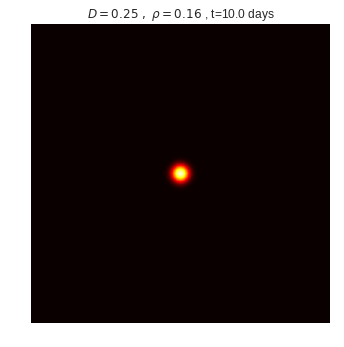

...t = 200...
vt1gd 0.25 vt2flair 0.5499999999999999 vgeom 0.3708099243547831 diff 6.0


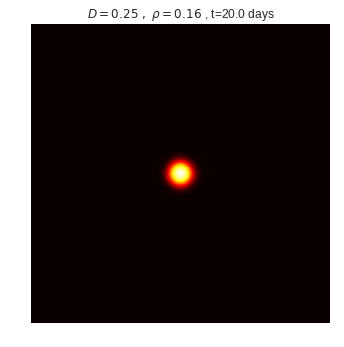

...t = 300...
vt1gd 0.23333333333333334 vt2flair 0.43333333333333335 vgeom 0.31797973380564853 diff 6.0


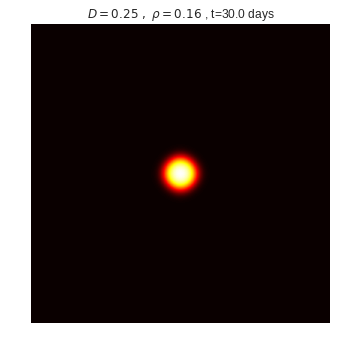

...t = 400...
vt1gd 0.27499999999999997 vt2flair 0.425 vgeom 0.34186985827943356 diff 6.0


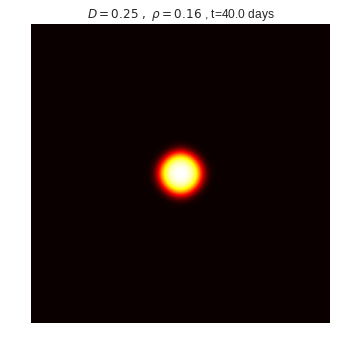

...t = 500...
vt1gd 0.25999999999999995 vt2flair 0.42 vgeom 0.3304542328371661 diff 8.0


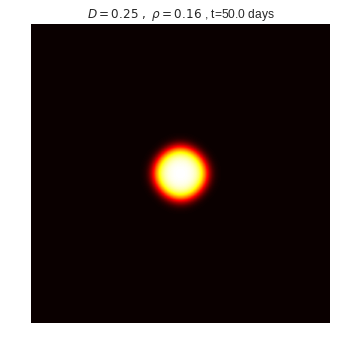

...t = 600...
vt1gd 0.2833333333333333 vt2flair 0.41666666666666663 vgeom 0.3435921354681384 diff 8.0


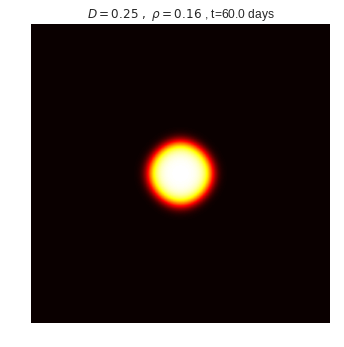

...t = 700...
vt1gd 0.3 vt2flair 0.41428571428571426 vgeom 0.3525417908358019 diff 8.0


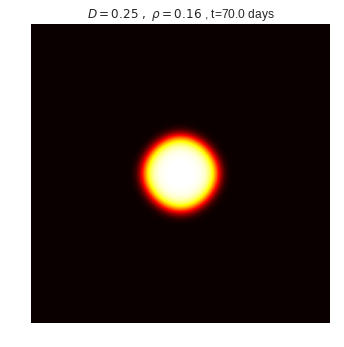

...t = 800...
vt1gd 0.3125 vt2flair 0.4125 vgeom 0.3590351654086268 diff 8.0


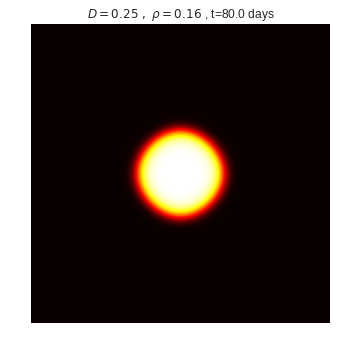

...t = 900...
vt1gd 0.3222222222222222 vt2flair 0.4111111111111111 vgeom 0.3639630967590933 diff 8.0


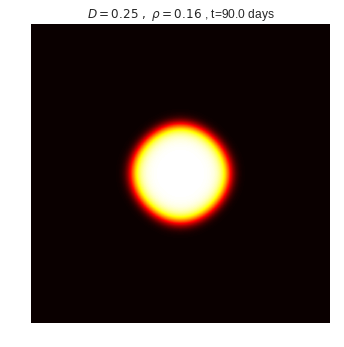

...t = 1000...
vt1gd 0.33 vt2flair 0.41 vgeom 0.3678314831549904 diff 8.0


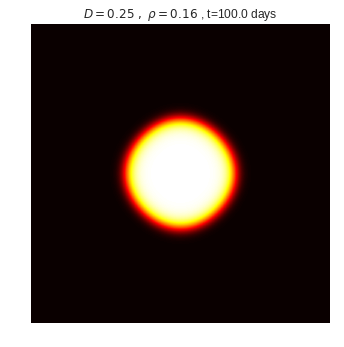

delta r: {'geom': [4.0, 6.0, 6.0, 6.0, 8.0, 8.0, 8.0, 8.0, 8.0, 8.0]}
speed :  {'t1gd': [0.3, 0.25, 0.23333333333333334, 0.27499999999999997, 0.25999999999999995, 0.2833333333333333, 0.3, 0.3125, 0.3222222222222222, 0.33], 't2flair': [0.7000000000000001, 0.5499999999999999, 0.43333333333333335, 0.425, 0.42, 0.41666666666666663, 0.41428571428571426, 0.4125, 0.4111111111111111, 0.41], 'geom': [0.45825756949558405, 0.3708099243547831, 0.31797973380564853, 0.34186985827943356, 0.3304542328371661, 0.3435921354681384, 0.3525417908358019, 0.3590351654086268, 0.3639630967590933, 0.3678314831549904]}

D = 1.1239999999999999 , rho = 0.16040000000000001
...t = 100...
vt1gd 0.3 vt2flair 0.7000000000000001 vgeom 0.45825756949558405 diff 4.0


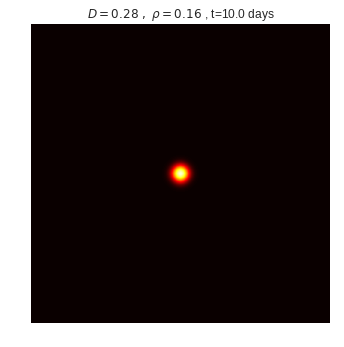

...t = 200...
vt1gd 0.25 vt2flair 0.5499999999999999 vgeom 0.3708099243547831 diff 6.0


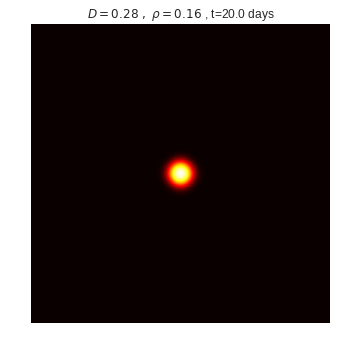

...t = 300...
vt1gd 0.23333333333333334 vt2flair 0.43333333333333335 vgeom 0.31797973380564853 diff 6.0


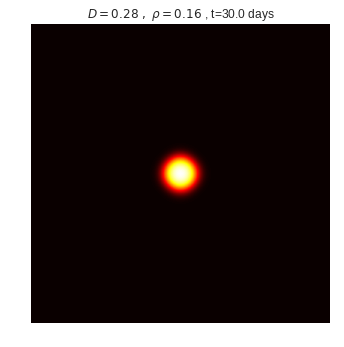

...t = 400...
vt1gd 0.27499999999999997 vt2flair 0.425 vgeom 0.34186985827943356 diff 6.0


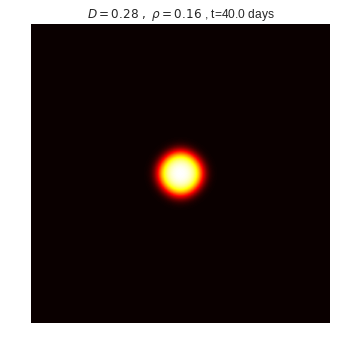

...t = 500...
vt1gd 0.25999999999999995 vt2flair 0.42 vgeom 0.3304542328371661 diff 8.0


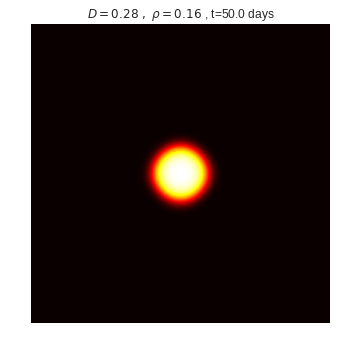

...t = 600...
vt1gd 0.2833333333333333 vt2flair 0.41666666666666663 vgeom 0.3435921354681384 diff 8.0


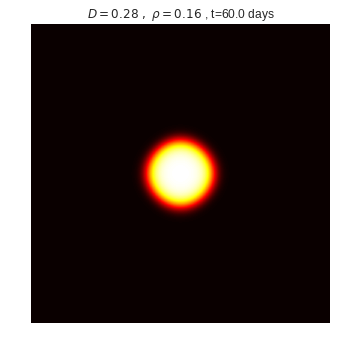

...t = 700...
vt1gd 0.3 vt2flair 0.41428571428571426 vgeom 0.3525417908358019 diff 8.0


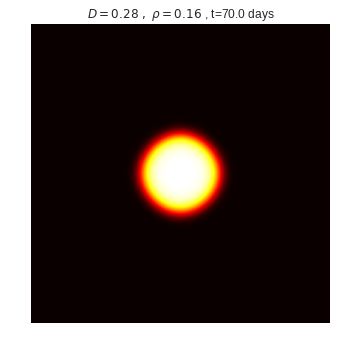

...t = 800...
vt1gd 0.3125 vt2flair 0.4125 vgeom 0.3590351654086268 diff 8.0


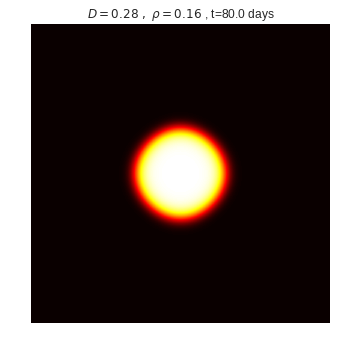

...t = 900...
vt1gd 0.3222222222222222 vt2flair 0.43333333333333335 vgeom 0.3736704826844497 diff 10.0


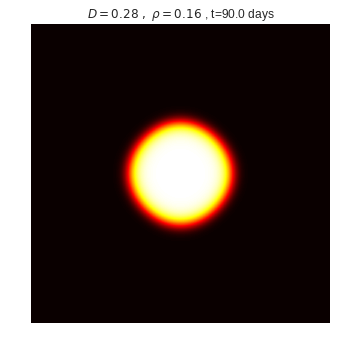

...t = 1000...
vt1gd 0.35000000000000003 vt2flair 0.42999999999999994 vgeom 0.38794329482541645 diff 8.0


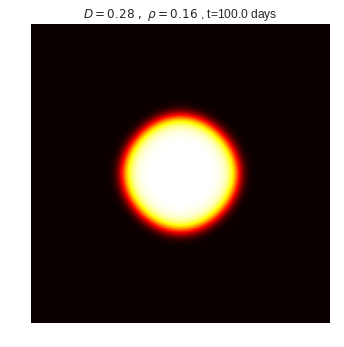

delta r: {'geom': [4.0, 6.0, 6.0, 6.0, 8.0, 8.0, 8.0, 8.0, 10.0, 8.0]}
speed :  {'t1gd': [0.3, 0.25, 0.23333333333333334, 0.27499999999999997, 0.25999999999999995, 0.2833333333333333, 0.3, 0.3125, 0.3222222222222222, 0.35000000000000003], 't2flair': [0.7000000000000001, 0.5499999999999999, 0.43333333333333335, 0.425, 0.42, 0.41666666666666663, 0.41428571428571426, 0.4125, 0.43333333333333335, 0.42999999999999994], 'geom': [0.45825756949558405, 0.3708099243547831, 0.31797973380564853, 0.34186985827943356, 0.3304542328371661, 0.3435921354681384, 0.3525417908358019, 0.3590351654086268, 0.3736704826844497, 0.38794329482541645]}

D = 1.2619999999999998 , rho = 0.16040000000000001
...t = 100...
vt1gd 0.3 vt2flair 0.7000000000000001 vgeom 0.45825756949558405 diff 4.0


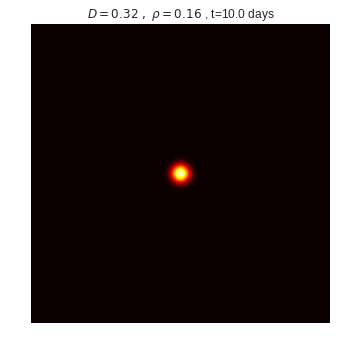

...t = 200...
vt1gd 0.25 vt2flair 0.5499999999999999 vgeom 0.3708099243547831 diff 6.0


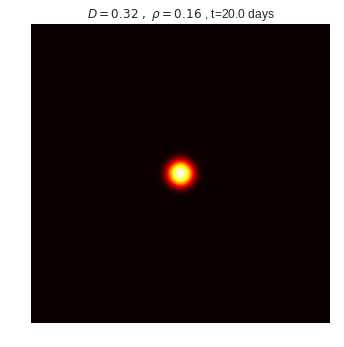

...t = 300...
vt1gd 0.23333333333333334 vt2flair 0.5 vgeom 0.3415650255319866 diff 8.0


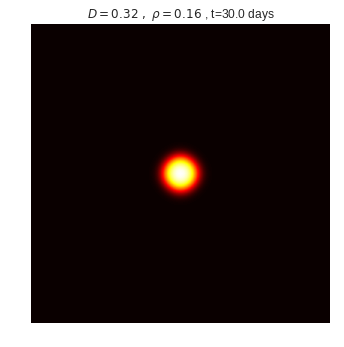

...t = 400...
vt1gd 0.27499999999999997 vt2flair 0.475 vgeom 0.361420807370024 diff 8.0


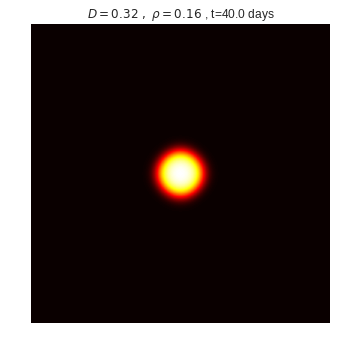

...t = 500...
vt1gd 0.3 vt2flair 0.45999999999999996 vgeom 0.37148351242013417 diff 8.0


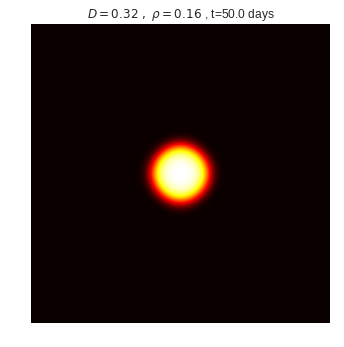

...t = 600...
vt1gd 0.31666666666666665 vt2flair 0.44999999999999996 vgeom 0.37749172176353746 diff 8.0


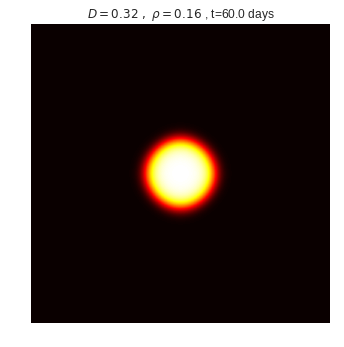

...t = 700...
vt1gd 0.3285714285714285 vt2flair 0.4428571428571428 vgeom 0.3814579977948196 diff 8.0


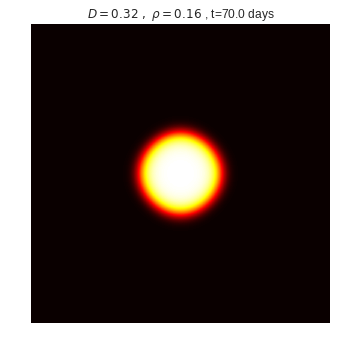

...t = 800...
vt1gd 0.3375 vt2flair 0.43749999999999994 vgeom 0.38426065372348495 diff 8.0


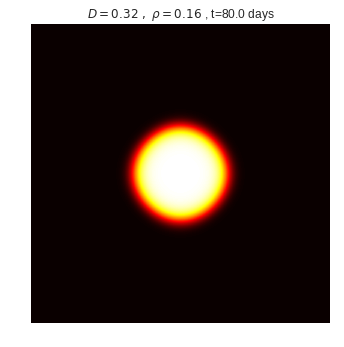

...t = 900...
vt1gd 0.34444444444444444 vt2flair 0.43333333333333335 vgeom 0.3863408589047491 diff 8.0


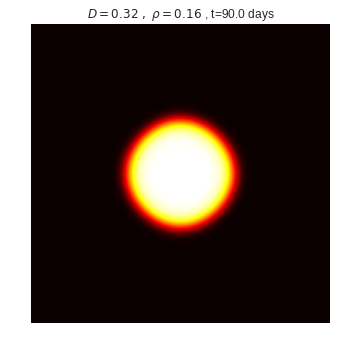

...t = 1000...
vt1gd 0.35000000000000003 vt2flair 0.44999999999999996 vgeom 0.3968626966596886 diff 10.0


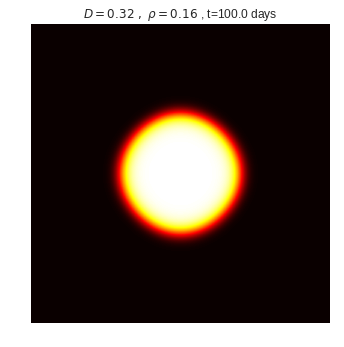

delta r: {'geom': [4.0, 6.0, 8.0, 8.0, 8.0, 8.0, 8.0, 8.0, 8.0, 10.0]}
speed :  {'t1gd': [0.3, 0.25, 0.23333333333333334, 0.27499999999999997, 0.3, 0.31666666666666665, 0.3285714285714285, 0.3375, 0.34444444444444444, 0.35000000000000003], 't2flair': [0.7000000000000001, 0.5499999999999999, 0.5, 0.475, 0.45999999999999996, 0.44999999999999996, 0.4428571428571428, 0.43749999999999994, 0.43333333333333335, 0.44999999999999996], 'geom': [0.45825756949558405, 0.3708099243547831, 0.3415650255319866, 0.361420807370024, 0.37148351242013417, 0.37749172176353746, 0.3814579977948196, 0.38426065372348495, 0.3863408589047491, 0.3968626966596886]}

D = 1.4 , rho = 0.16040000000000001
...t = 100...
vt1gd 0.3 vt2flair 0.7000000000000001 vgeom 0.45825756949558405 diff 4.0


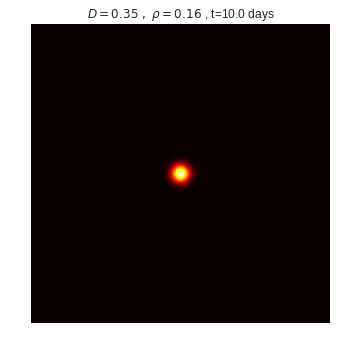

...t = 200...
vt1gd 0.25 vt2flair 0.5499999999999999 vgeom 0.3708099243547831 diff 6.0


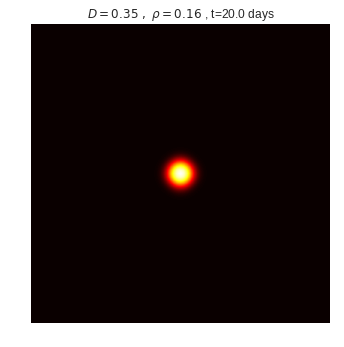

...t = 300...
vt1gd 0.23333333333333334 vt2flair 0.5 vgeom 0.3415650255319866 diff 8.0


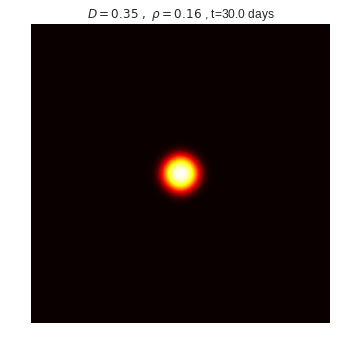

...t = 400...
vt1gd 0.27499999999999997 vt2flair 0.475 vgeom 0.361420807370024 diff 8.0


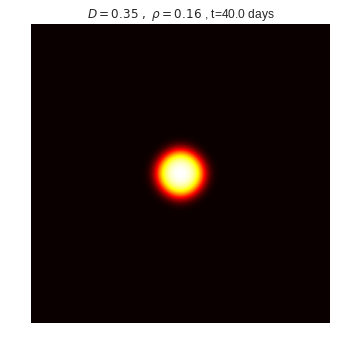

...t = 500...
vt1gd 0.3 vt2flair 0.45999999999999996 vgeom 0.37148351242013417 diff 8.0


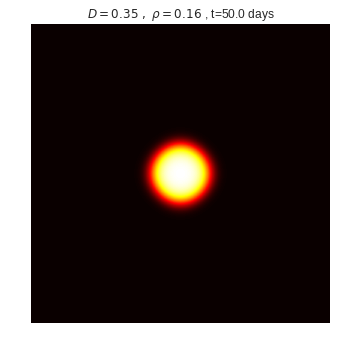

...t = 600...
vt1gd 0.31666666666666665 vt2flair 0.44999999999999996 vgeom 0.37749172176353746 diff 8.0


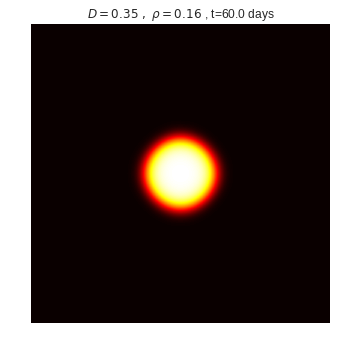

...t = 700...
vt1gd 0.3285714285714285 vt2flair 0.4714285714285714 vgeom 0.39357078039874027 diff 10.0


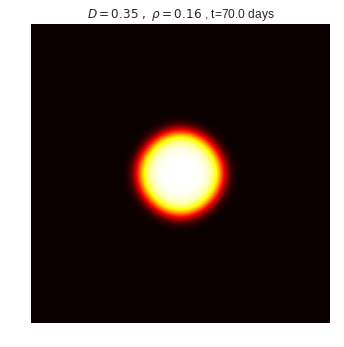

...t = 800...
vt1gd 0.3375 vt2flair 0.46249999999999997 vgeom 0.3950870157319777 diff 10.0


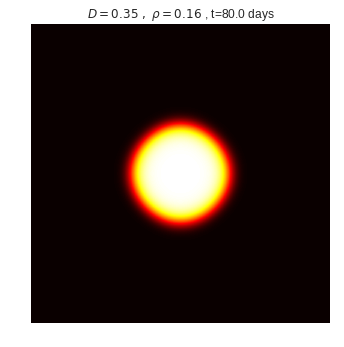

...t = 900...
vt1gd 0.36666666666666664 vt2flair 0.45555555555555555 vgeom 0.4087016479499893 diff 8.0


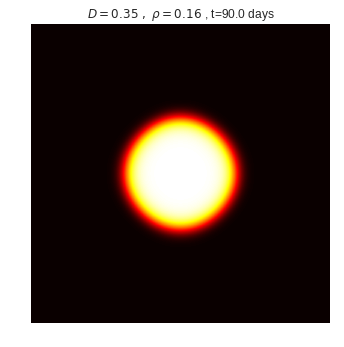

...t = 1000...
vt1gd 0.36999999999999994 vt2flair 0.47 vgeom 0.4170131892398608 diff 10.0


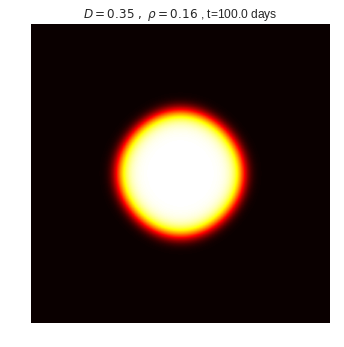

delta r: {'geom': [4.0, 6.0, 8.0, 8.0, 8.0, 8.0, 10.0, 10.0, 8.0, 10.0]}
speed :  {'t1gd': [0.3, 0.25, 0.23333333333333334, 0.27499999999999997, 0.3, 0.31666666666666665, 0.3285714285714285, 0.3375, 0.36666666666666664, 0.36999999999999994], 't2flair': [0.7000000000000001, 0.5499999999999999, 0.5, 0.475, 0.45999999999999996, 0.44999999999999996, 0.4714285714285714, 0.46249999999999997, 0.45555555555555555, 0.47], 'geom': [0.45825756949558405, 0.3708099243547831, 0.3415650255319866, 0.361420807370024, 0.37148351242013417, 0.37749172176353746, 0.39357078039874027, 0.3950870157319777, 0.4087016479499893, 0.4170131892398608]}

D = 0.9859999999999999 , rho = 0.18020000000000003
...t = 100...
vt1gd 0.3 vt2flair 0.7000000000000001 vgeom 0.45825756949558405 diff 4.0


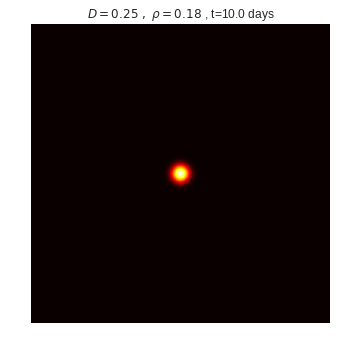

...t = 200...
vt1gd 0.25 vt2flair 0.5499999999999999 vgeom 0.3708099243547831 diff 6.0


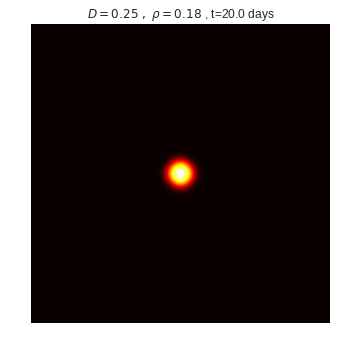

...t = 300...
vt1gd 0.23333333333333334 vt2flair 0.5 vgeom 0.3415650255319866 diff 8.0


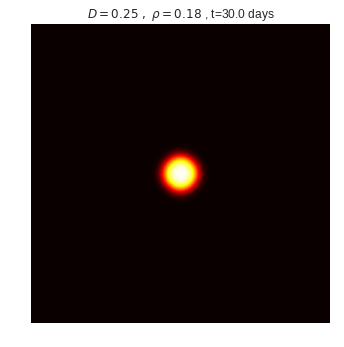

...t = 400...
vt1gd 0.27499999999999997 vt2flair 0.475 vgeom 0.361420807370024 diff 8.0


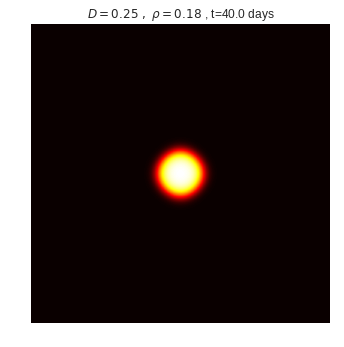

...t = 500...
vt1gd 0.3 vt2flair 0.45999999999999996 vgeom 0.37148351242013417 diff 8.0


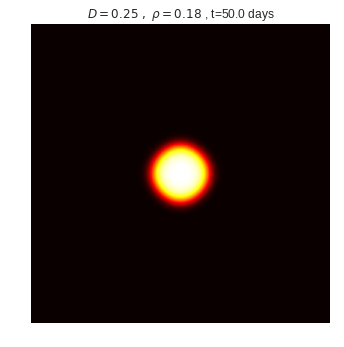

...t = 600...
vt1gd 0.31666666666666665 vt2flair 0.44999999999999996 vgeom 0.37749172176353746 diff 8.0


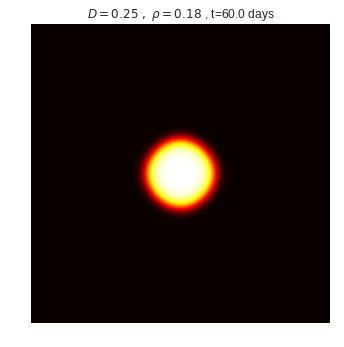

...t = 700...
vt1gd 0.3285714285714285 vt2flair 0.4428571428571428 vgeom 0.3814579977948196 diff 8.0


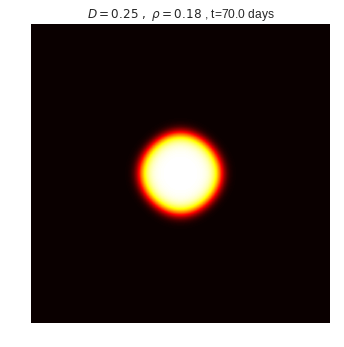

...t = 800...
vt1gd 0.3375 vt2flair 0.43749999999999994 vgeom 0.38426065372348495 diff 8.0


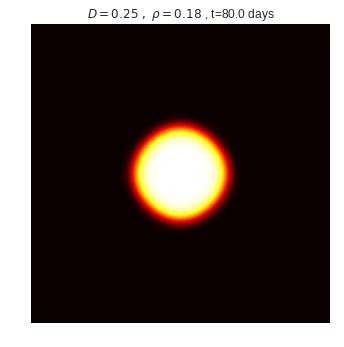

...t = 900...
vt1gd 0.34444444444444444 vt2flair 0.43333333333333335 vgeom 0.3863408589047491 diff 8.0


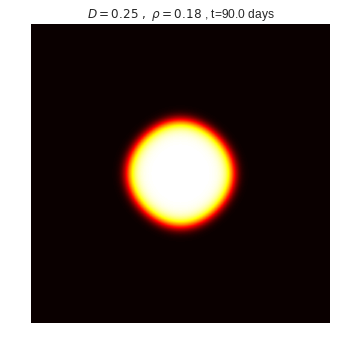

...t = 1000...
vt1gd 0.35000000000000003 vt2flair 0.42999999999999994 vgeom 0.38794329482541645 diff 8.0


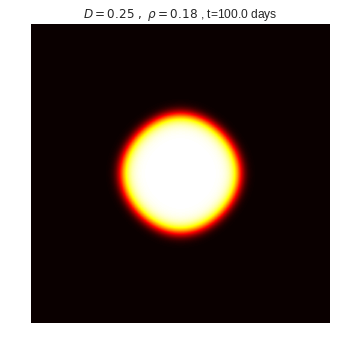

delta r: {'geom': [4.0, 6.0, 8.0, 8.0, 8.0, 8.0, 8.0, 8.0, 8.0, 8.0]}
speed :  {'t1gd': [0.3, 0.25, 0.23333333333333334, 0.27499999999999997, 0.3, 0.31666666666666665, 0.3285714285714285, 0.3375, 0.34444444444444444, 0.35000000000000003], 't2flair': [0.7000000000000001, 0.5499999999999999, 0.5, 0.475, 0.45999999999999996, 0.44999999999999996, 0.4428571428571428, 0.43749999999999994, 0.43333333333333335, 0.42999999999999994], 'geom': [0.45825756949558405, 0.3708099243547831, 0.3415650255319866, 0.361420807370024, 0.37148351242013417, 0.37749172176353746, 0.3814579977948196, 0.38426065372348495, 0.3863408589047491, 0.38794329482541645]}

D = 1.1239999999999999 , rho = 0.18020000000000003
...t = 100...
vt1gd 0.3 vt2flair 0.7000000000000001 vgeom 0.45825756949558405 diff 4.0


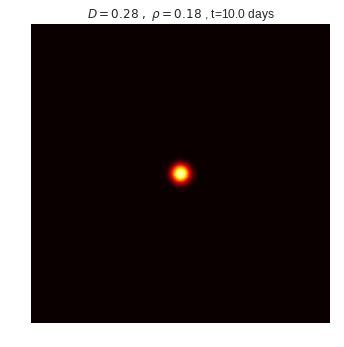

...t = 200...
vt1gd 0.25 vt2flair 0.5499999999999999 vgeom 0.3708099243547831 diff 6.0


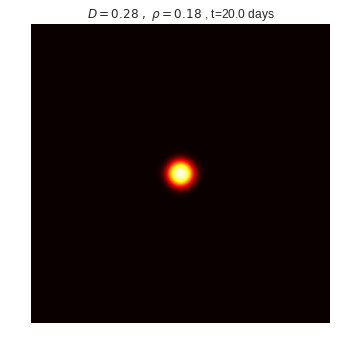

...t = 300...
vt1gd 0.3 vt2flair 0.5 vgeom 0.3872983346207417 diff 6.0


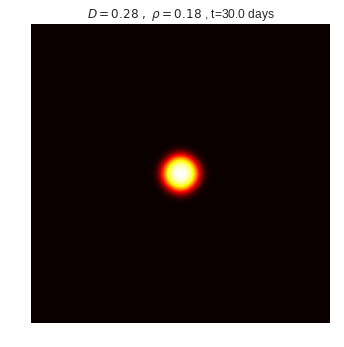

...t = 400...
vt1gd 0.27499999999999997 vt2flair 0.475 vgeom 0.361420807370024 diff 8.0


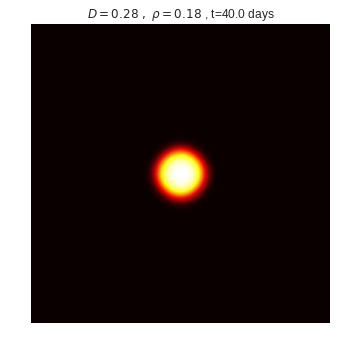

...t = 500...
vt1gd 0.3 vt2flair 0.45999999999999996 vgeom 0.37148351242013417 diff 8.0


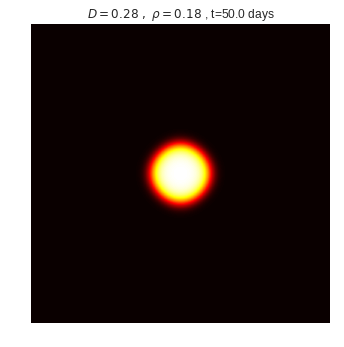

...t = 600...
vt1gd 0.31666666666666665 vt2flair 0.44999999999999996 vgeom 0.37749172176353746 diff 8.0


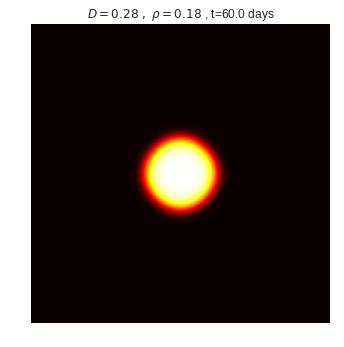

...t = 700...
vt1gd 0.3571428571428571 vt2flair 0.4428571428571428 vgeom 0.39769745448785865 diff 6.0


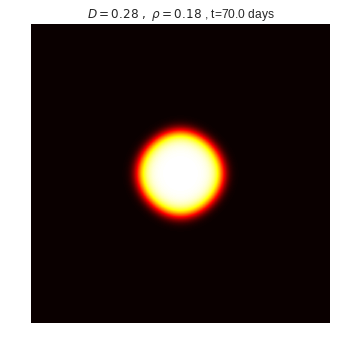

...t = 800...
vt1gd 0.36249999999999993 vt2flair 0.46249999999999997 vgeom 0.4094584838539799 diff 8.0


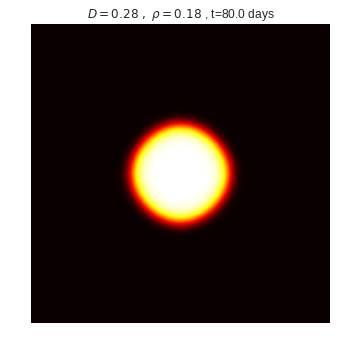

...t = 900...
vt1gd 0.36666666666666664 vt2flair 0.45555555555555555 vgeom 0.4087016479499893 diff 8.0


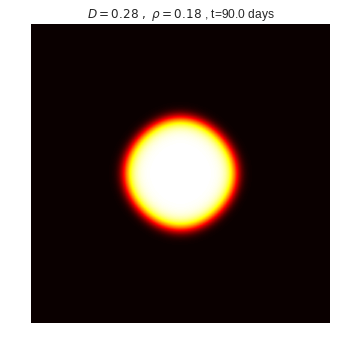

...t = 1000...
vt1gd 0.36999999999999994 vt2flair 0.44999999999999996 vgeom 0.40804411526206325 diff 8.0


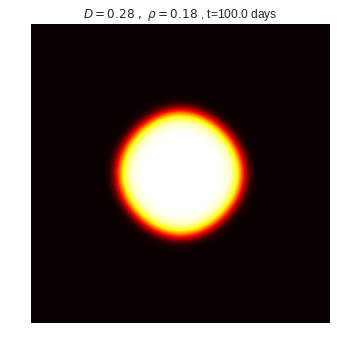

delta r: {'geom': [4.0, 6.0, 6.0, 8.0, 8.0, 8.0, 6.0, 8.0, 8.0, 8.0]}
speed :  {'t1gd': [0.3, 0.25, 0.3, 0.27499999999999997, 0.3, 0.31666666666666665, 0.3571428571428571, 0.36249999999999993, 0.36666666666666664, 0.36999999999999994], 't2flair': [0.7000000000000001, 0.5499999999999999, 0.5, 0.475, 0.45999999999999996, 0.44999999999999996, 0.4428571428571428, 0.46249999999999997, 0.45555555555555555, 0.44999999999999996], 'geom': [0.45825756949558405, 0.3708099243547831, 0.3872983346207417, 0.361420807370024, 0.37148351242013417, 0.37749172176353746, 0.39769745448785865, 0.4094584838539799, 0.4087016479499893, 0.40804411526206325]}

D = 1.2619999999999998 , rho = 0.18020000000000003
...t = 100...
vt1gd 0.3 vt2flair 0.7000000000000001 vgeom 0.45825756949558405 diff 4.0


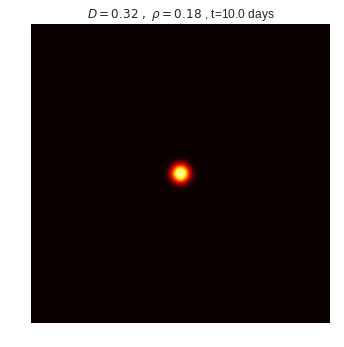

...t = 200...
vt1gd 0.25 vt2flair 0.5499999999999999 vgeom 0.3708099243547831 diff 6.0


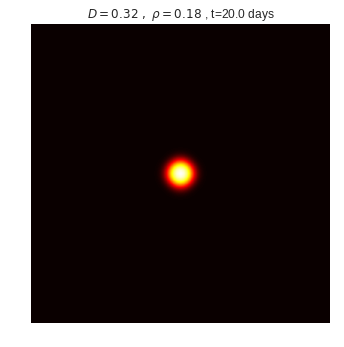

...t = 300...
vt1gd 0.3 vt2flair 0.5 vgeom 0.3872983346207417 diff 6.0


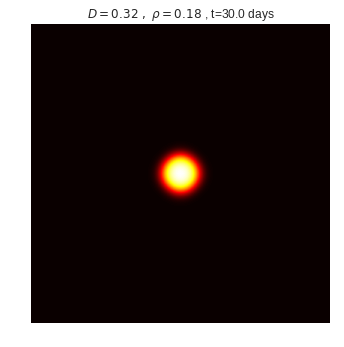

...t = 400...
vt1gd 0.325 vt2flair 0.475 vgeom 0.39290584113754273 diff 6.0


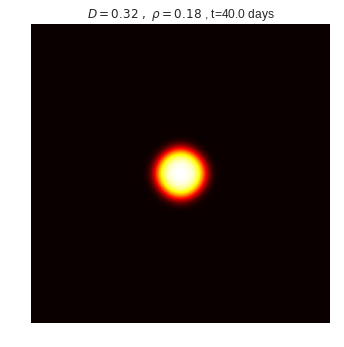

...t = 500...
vt1gd 0.34 vt2flair 0.5 vgeom 0.41231056256176607 diff 8.0


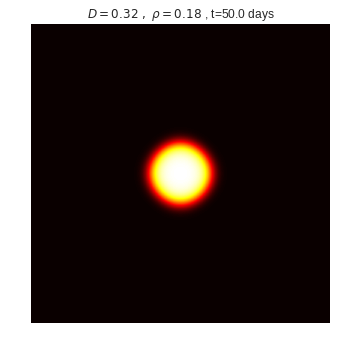

...t = 600...
vt1gd 0.35000000000000003 vt2flair 0.4833333333333333 vgeom 0.4112987559751022 diff 8.0


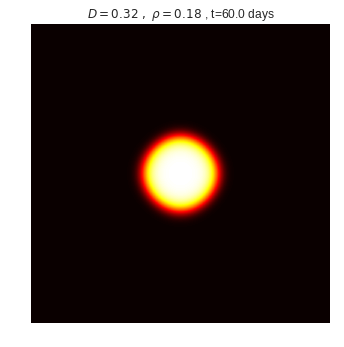

...t = 700...
vt1gd 0.3571428571428571 vt2flair 0.4714285714285714 vgeom 0.41032590332414487 diff 8.0


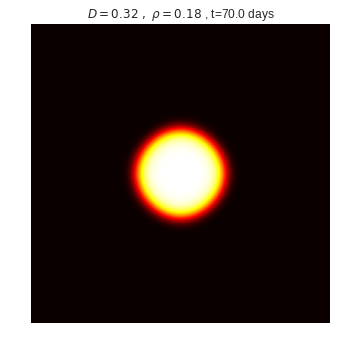

...t = 800...
vt1gd 0.36249999999999993 vt2flair 0.4875 vgeom 0.4203792930200059 diff 10.0


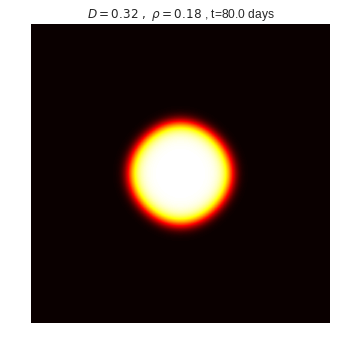

...t = 900...
vt1gd 0.3888888888888889 vt2flair 0.4777777777777778 vgeom 0.43104810536157384 diff 8.0


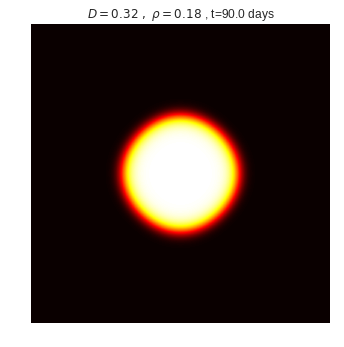

...t = 1000...
vt1gd 0.38999999999999996 vt2flair 0.47 vgeom 0.4281354925721529 diff 8.0


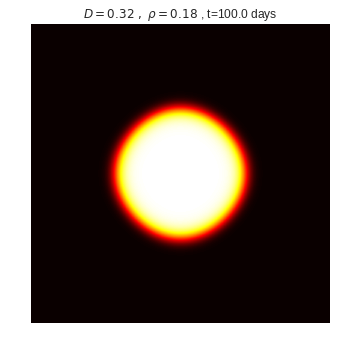

delta r: {'geom': [4.0, 6.0, 6.0, 6.0, 8.0, 8.0, 8.0, 10.0, 8.0, 8.0]}
speed :  {'t1gd': [0.3, 0.25, 0.3, 0.325, 0.34, 0.35000000000000003, 0.3571428571428571, 0.36249999999999993, 0.3888888888888889, 0.38999999999999996], 't2flair': [0.7000000000000001, 0.5499999999999999, 0.5, 0.475, 0.5, 0.4833333333333333, 0.4714285714285714, 0.4875, 0.4777777777777778, 0.47], 'geom': [0.45825756949558405, 0.3708099243547831, 0.3872983346207417, 0.39290584113754273, 0.41231056256176607, 0.4112987559751022, 0.41032590332414487, 0.4203792930200059, 0.43104810536157384, 0.4281354925721529]}

D = 1.4 , rho = 0.18020000000000003
...t = 100...
vt1gd 0.3 vt2flair 0.7000000000000001 vgeom 0.45825756949558405 diff 4.0


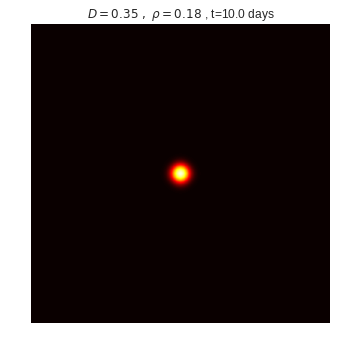

...t = 200...
vt1gd 0.25 vt2flair 0.5499999999999999 vgeom 0.3708099243547831 diff 6.0


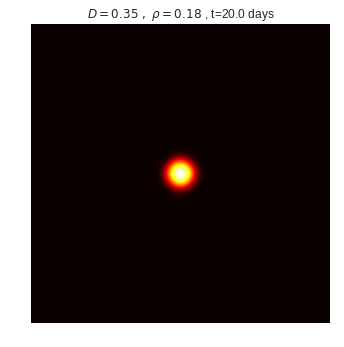

...t = 300...
vt1gd 0.3 vt2flair 0.5 vgeom 0.3872983346207417 diff 6.0


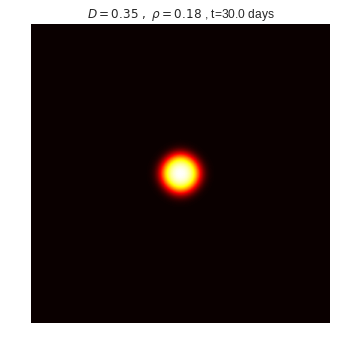

...t = 400...
vt1gd 0.325 vt2flair 0.5249999999999999 vgeom 0.41306779104645763 diff 8.0


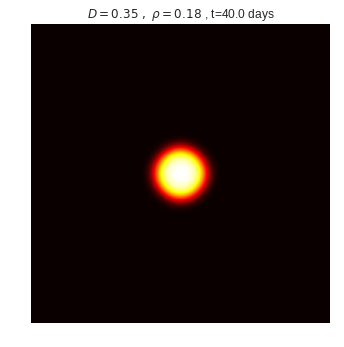

...t = 500...
vt1gd 0.34 vt2flair 0.5 vgeom 0.41231056256176607 diff 8.0


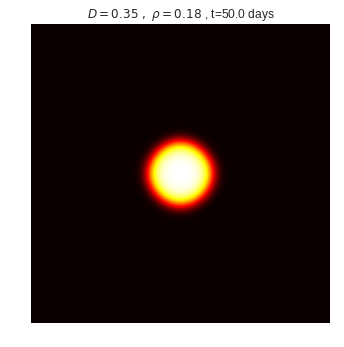

...t = 600...
vt1gd 0.35000000000000003 vt2flair 0.4833333333333333 vgeom 0.4112987559751022 diff 8.0


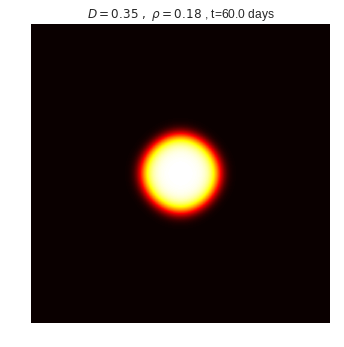

...t = 700...
vt1gd 0.3857142857142857 vt2flair 0.5 vgeom 0.43915503282683993 diff 8.0


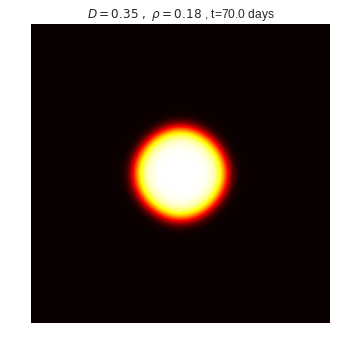

...t = 800...
vt1gd 0.38749999999999996 vt2flair 0.4875 vgeom 0.4346334662678427 diff 8.0


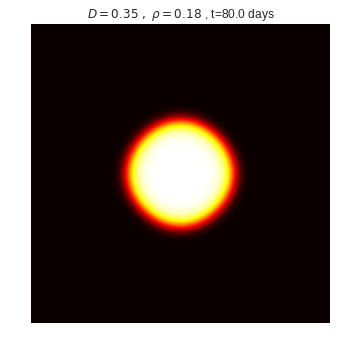

...t = 900...
vt1gd 0.3888888888888889 vt2flair 0.5 vgeom 0.44095855184409843 diff 10.0


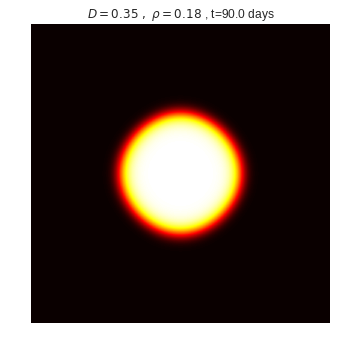

...t = 1000...
vt1gd 0.41 vt2flair 0.49 vgeom 0.4482186966202994 diff 8.0


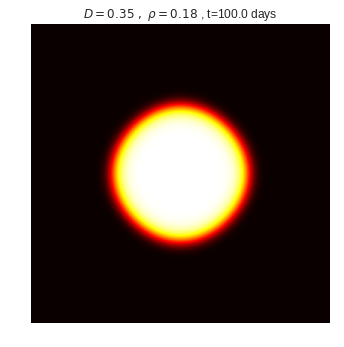

delta r: {'geom': [4.0, 6.0, 6.0, 8.0, 8.0, 8.0, 8.0, 8.0, 10.0, 8.0]}
speed :  {'t1gd': [0.3, 0.25, 0.3, 0.325, 0.34, 0.35000000000000003, 0.3857142857142857, 0.38749999999999996, 0.3888888888888889, 0.41], 't2flair': [0.7000000000000001, 0.5499999999999999, 0.5, 0.5249999999999999, 0.5, 0.4833333333333333, 0.5, 0.4875, 0.5, 0.49], 'geom': [0.45825756949558405, 0.3708099243547831, 0.3872983346207417, 0.41306779104645763, 0.41231056256176607, 0.4112987559751022, 0.43915503282683993, 0.4346334662678427, 0.44095855184409843, 0.4482186966202994]}

D = 0.9859999999999999 , rho = 0.2
...t = 100...
vt1gd 0.3 vt2flair 0.7000000000000001 vgeom 0.45825756949558405 diff 4.0


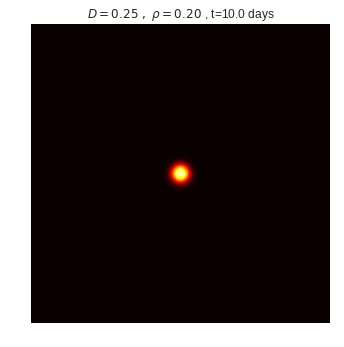

...t = 200...
vt1gd 0.25 vt2flair 0.5499999999999999 vgeom 0.3708099243547831 diff 6.0


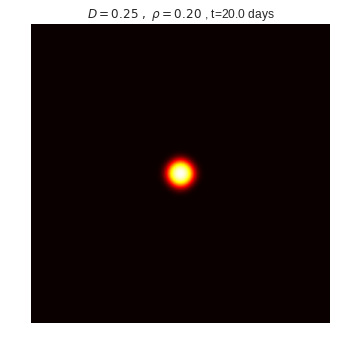

...t = 300...
vt1gd 0.3 vt2flair 0.5 vgeom 0.3872983346207417 diff 6.0


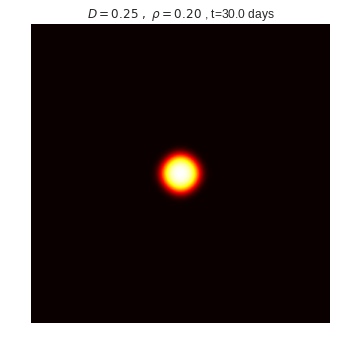

...t = 400...
vt1gd 0.325 vt2flair 0.475 vgeom 0.39290584113754273 diff 6.0


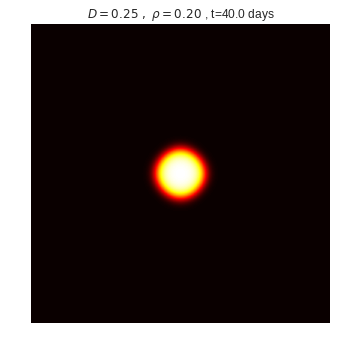

...t = 500...
vt1gd 0.34 vt2flair 0.45999999999999996 vgeom 0.3954743986657038 diff 6.0


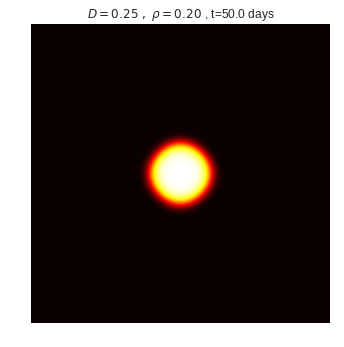

...t = 600...
vt1gd 0.35000000000000003 vt2flair 0.44999999999999996 vgeom 0.3968626966596886 diff 6.0


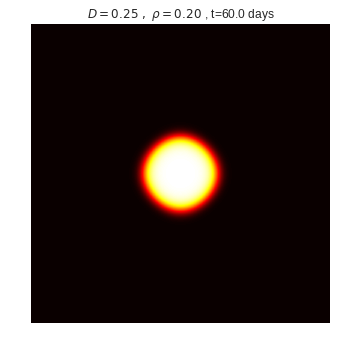

...t = 700...
vt1gd 0.3571428571428571 vt2flair 0.4714285714285714 vgeom 0.41032590332414487 diff 8.0


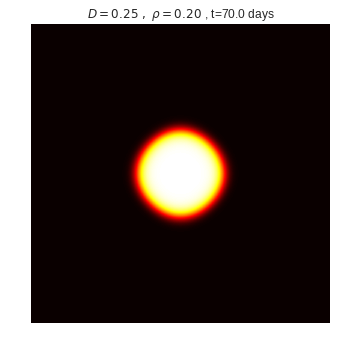

...t = 800...
vt1gd 0.36249999999999993 vt2flair 0.46249999999999997 vgeom 0.4094584838539799 diff 8.0


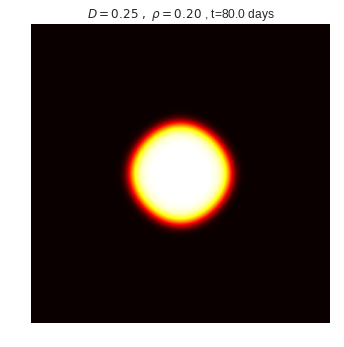

...t = 900...
vt1gd 0.3888888888888889 vt2flair 0.45555555555555555 vgeom 0.42090437610835135 diff 6.0


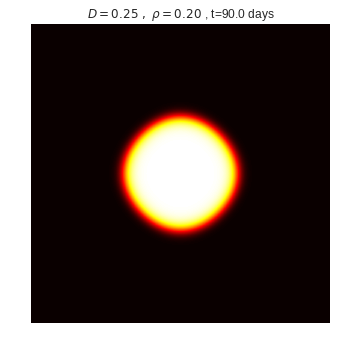

...t = 1000...
vt1gd 0.38999999999999996 vt2flair 0.47 vgeom 0.4281354925721529 diff 8.0


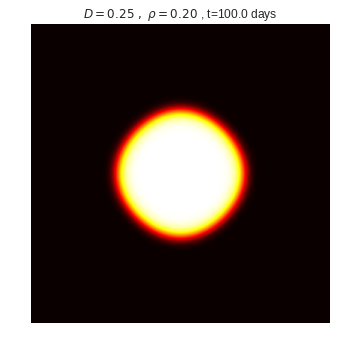

delta r: {'geom': [4.0, 6.0, 6.0, 6.0, 6.0, 6.0, 8.0, 8.0, 6.0, 8.0]}
speed :  {'t1gd': [0.3, 0.25, 0.3, 0.325, 0.34, 0.35000000000000003, 0.3571428571428571, 0.36249999999999993, 0.3888888888888889, 0.38999999999999996], 't2flair': [0.7000000000000001, 0.5499999999999999, 0.5, 0.475, 0.45999999999999996, 0.44999999999999996, 0.4714285714285714, 0.46249999999999997, 0.45555555555555555, 0.47], 'geom': [0.45825756949558405, 0.3708099243547831, 0.3872983346207417, 0.39290584113754273, 0.3954743986657038, 0.3968626966596886, 0.41032590332414487, 0.4094584838539799, 0.42090437610835135, 0.4281354925721529]}

D = 1.1239999999999999 , rho = 0.2
...t = 100...
vt1gd 0.3 vt2flair 0.7000000000000001 vgeom 0.45825756949558405 diff 4.0


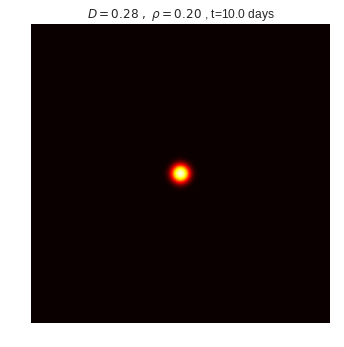

...t = 200...
vt1gd 0.25 vt2flair 0.5499999999999999 vgeom 0.3708099243547831 diff 6.0


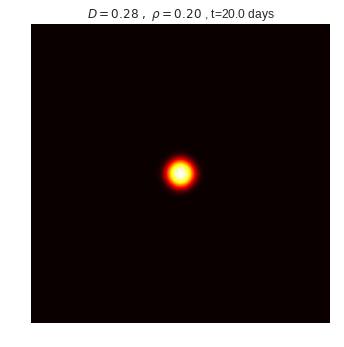

...t = 300...
vt1gd 0.3 vt2flair 0.5 vgeom 0.3872983346207417 diff 6.0


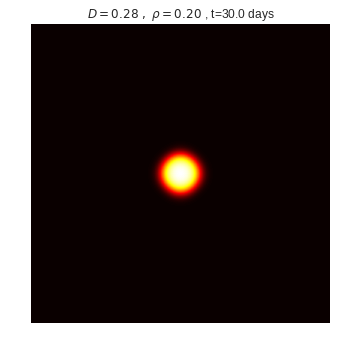

...t = 400...
vt1gd 0.325 vt2flair 0.5249999999999999 vgeom 0.41306779104645763 diff 8.0


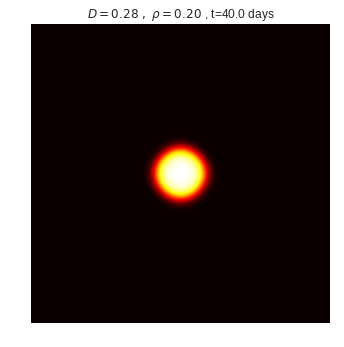

...t = 500...
vt1gd 0.34 vt2flair 0.5 vgeom 0.41231056256176607 diff 8.0


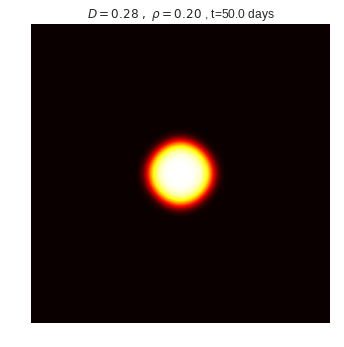

...t = 600...
vt1gd 0.35000000000000003 vt2flair 0.4833333333333333 vgeom 0.4112987559751022 diff 8.0


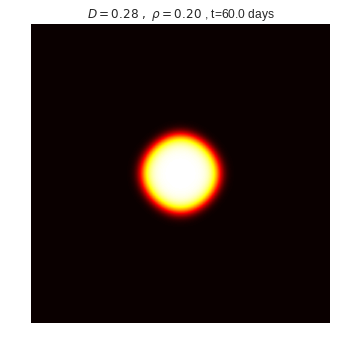

...t = 700...
vt1gd 0.3857142857142857 vt2flair 0.4714285714285714 vgeom 0.42642318733140855 diff 6.0


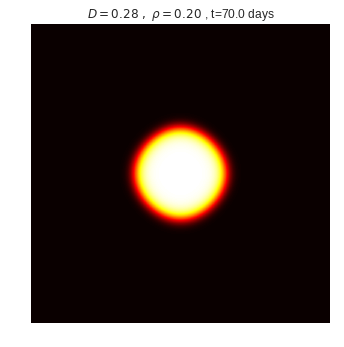

...t = 800...
vt1gd 0.38749999999999996 vt2flair 0.4875 vgeom 0.4346334662678427 diff 8.0


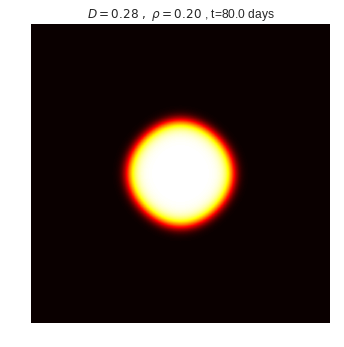

...t = 900...
vt1gd 0.4111111111111111 vt2flair 0.4777777777777778 vgeom 0.44319268167064735 diff 6.0


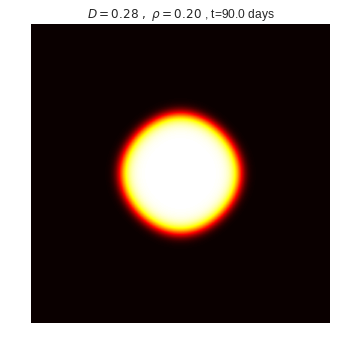

...t = 1000...
vt1gd 0.41 vt2flair 0.49 vgeom 0.4482186966202994 diff 8.0


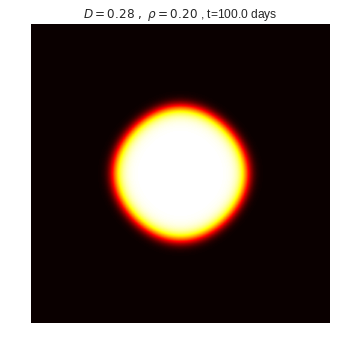

delta r: {'geom': [4.0, 6.0, 6.0, 8.0, 8.0, 8.0, 6.0, 8.0, 6.0, 8.0]}
speed :  {'t1gd': [0.3, 0.25, 0.3, 0.325, 0.34, 0.35000000000000003, 0.3857142857142857, 0.38749999999999996, 0.4111111111111111, 0.41], 't2flair': [0.7000000000000001, 0.5499999999999999, 0.5, 0.5249999999999999, 0.5, 0.4833333333333333, 0.4714285714285714, 0.4875, 0.4777777777777778, 0.49], 'geom': [0.45825756949558405, 0.3708099243547831, 0.3872983346207417, 0.41306779104645763, 0.41231056256176607, 0.4112987559751022, 0.42642318733140855, 0.4346334662678427, 0.44319268167064735, 0.4482186966202994]}

D = 1.2619999999999998 , rho = 0.2
...t = 100...
vt1gd 0.3 vt2flair 0.7000000000000001 vgeom 0.45825756949558405 diff 4.0


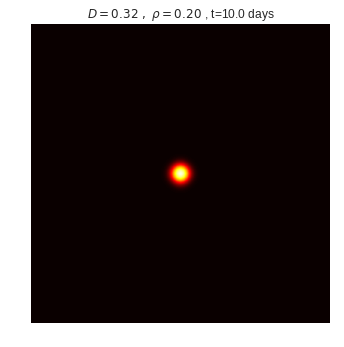

...t = 200...
vt1gd 0.25 vt2flair 0.5499999999999999 vgeom 0.3708099243547831 diff 6.0


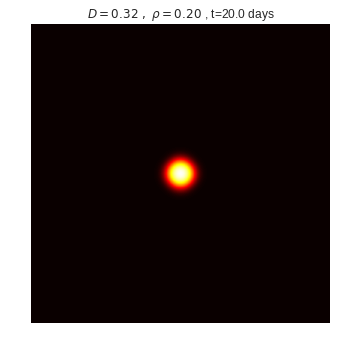

...t = 300...
vt1gd 0.3 vt2flair 0.5666666666666667 vgeom 0.412310562561766 diff 8.0


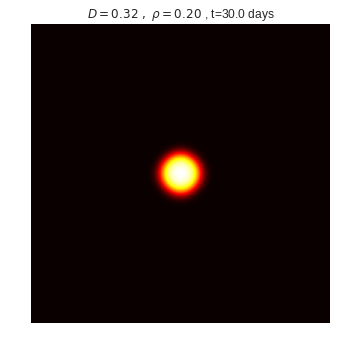

...t = 400...
vt1gd 0.325 vt2flair 0.5249999999999999 vgeom 0.41306779104645763 diff 8.0


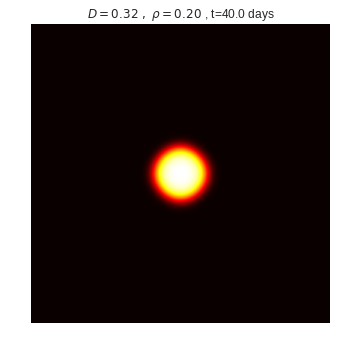

...t = 500...
vt1gd 0.37999999999999995 vt2flair 0.5 vgeom 0.43588989435406733 diff 6.0


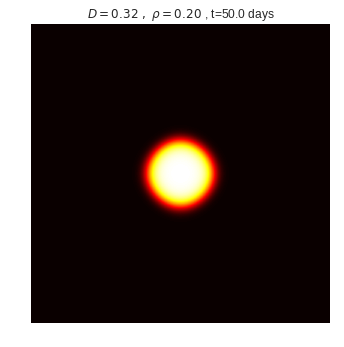

...t = 600...
vt1gd 0.3833333333333333 vt2flair 0.5166666666666666 vgeom 0.44503433076062293 diff 8.0


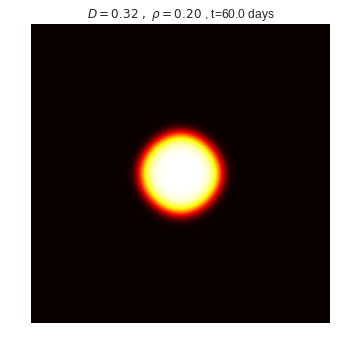

...t = 700...
vt1gd 0.3857142857142857 vt2flair 0.5 vgeom 0.43915503282683993 diff 8.0


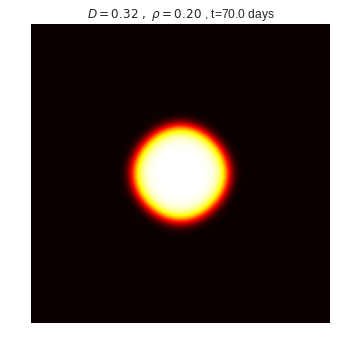

...t = 800...
vt1gd 0.4125 vt2flair 0.5125 vgeom 0.459789353943738 diff 8.0


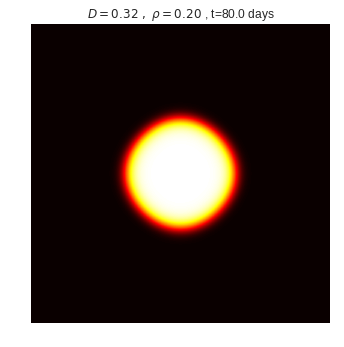

...t = 900...
vt1gd 0.4111111111111111 vt2flair 0.5 vgeom 0.45338235029118146 diff 8.0


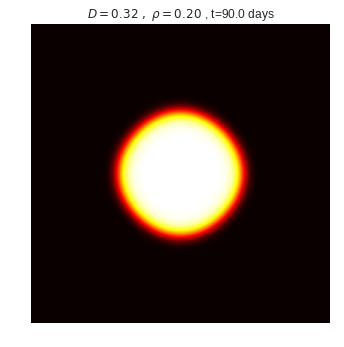

...t = 1000...
vt1gd 0.42999999999999994 vt2flair 0.5099999999999999 vgeom 0.46829477895872373 diff 8.0


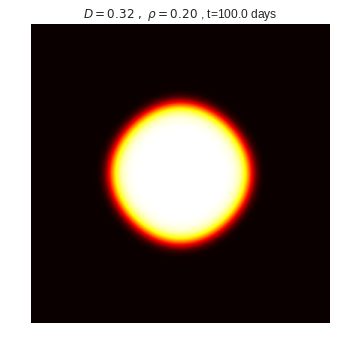

delta r: {'geom': [4.0, 6.0, 8.0, 8.0, 6.0, 8.0, 8.0, 8.0, 8.0, 8.0]}
speed :  {'t1gd': [0.3, 0.25, 0.3, 0.325, 0.37999999999999995, 0.3833333333333333, 0.3857142857142857, 0.4125, 0.4111111111111111, 0.42999999999999994], 't2flair': [0.7000000000000001, 0.5499999999999999, 0.5666666666666667, 0.5249999999999999, 0.5, 0.5166666666666666, 0.5, 0.5125, 0.5, 0.5099999999999999], 'geom': [0.45825756949558405, 0.3708099243547831, 0.412310562561766, 0.41306779104645763, 0.43588989435406733, 0.44503433076062293, 0.43915503282683993, 0.459789353943738, 0.45338235029118146, 0.46829477895872373]}

D = 1.4 , rho = 0.2
...t = 100...
vt1gd 0.3 vt2flair 0.8999999999999999 vgeom 0.5196152422706631 diff 6.0


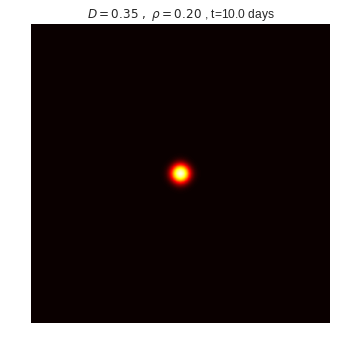

...t = 200...
vt1gd 0.25 vt2flair 0.65 vgeom 0.4031128874149275 diff 8.0


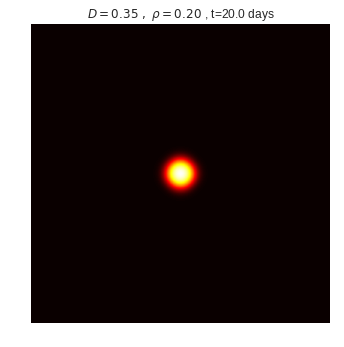

...t = 300...
vt1gd 0.3 vt2flair 0.5666666666666667 vgeom 0.412310562561766 diff 8.0


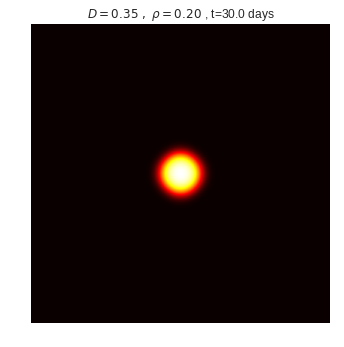

...t = 400...
vt1gd 0.325 vt2flair 0.5249999999999999 vgeom 0.41306779104645763 diff 8.0


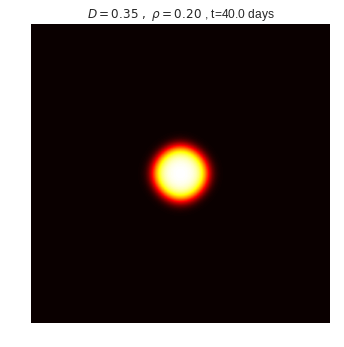

...t = 500...
vt1gd 0.37999999999999995 vt2flair 0.5399999999999999 vgeom 0.4529900661162449 diff 8.0


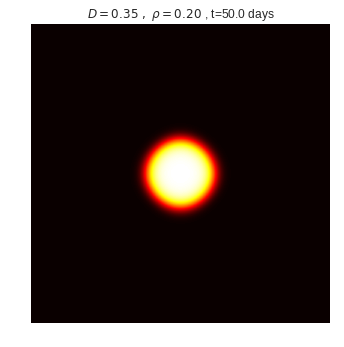

...t = 600...
vt1gd 0.3833333333333333 vt2flair 0.5166666666666666 vgeom 0.44503433076062293 diff 8.0


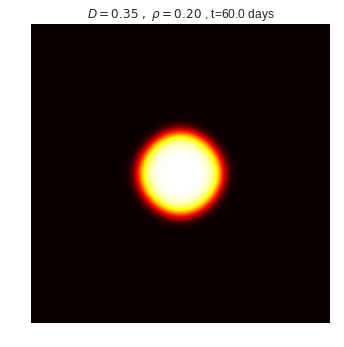

...t = 700...
vt1gd 0.41428571428571426 vt2flair 0.5285714285714286 vgeom 0.46795255297597715 diff 8.0


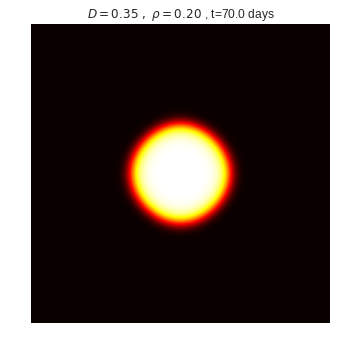

...t = 800...
vt1gd 0.4125 vt2flair 0.5375 vgeom 0.4708702050459341 diff 10.0


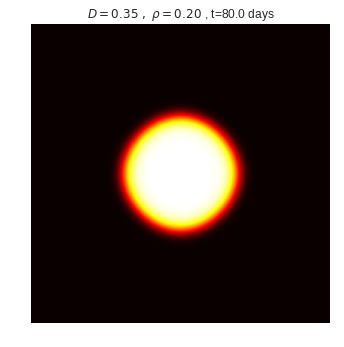

...t = 900...
vt1gd 0.43333333333333335 vt2flair 0.5222222222222223 vgeom 0.47570610285794773 diff 8.0


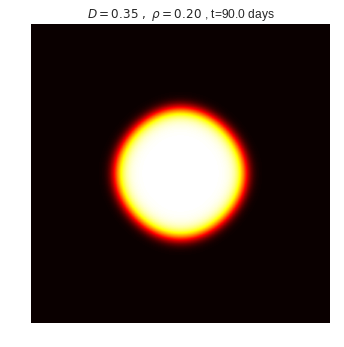

...t = 1000...
vt1gd 0.44999999999999996 vt2flair 0.5299999999999999 vgeom 0.4883646178829911 diff 8.0


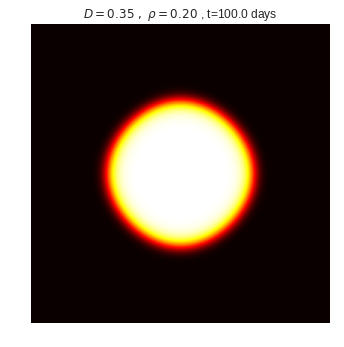

delta r: {'geom': [6.0, 8.0, 8.0, 8.0, 8.0, 8.0, 8.0, 10.0, 8.0, 8.0]}
speed :  {'t1gd': [0.3, 0.25, 0.3, 0.325, 0.37999999999999995, 0.3833333333333333, 0.41428571428571426, 0.4125, 0.43333333333333335, 0.44999999999999996], 't2flair': [0.8999999999999999, 0.65, 0.5666666666666667, 0.5249999999999999, 0.5399999999999999, 0.5166666666666666, 0.5285714285714286, 0.5375, 0.5222222222222223, 0.5299999999999999], 'geom': [0.5196152422706631, 0.4031128874149275, 0.412310562561766, 0.41306779104645763, 0.4529900661162449, 0.44503433076062293, 0.46795255297597715, 0.4708702050459341, 0.47570610285794773, 0.4883646178829911]}



In [41]:
U = []
for rho in rhos:
  for D in Ds:
    print('D =', D, ', rho =', rho)
    cn2D = CNicholson2D(D=D, rho=rho, Lx=200, Ly=200, Nx=100, Ny=100, T=100.1, sigma=10)
    u = cn2D.simulation()
    U.append(u)
    print('delta r:', u[1])
    print('speed : ', u[2])
    print()

Load the results from google drive.

In [0]:
path = '/content/gdrive/My Drive/MEDICAL_IMAGE_ANALYSIS/'
Ds, rhos, Us, distances, vitesses = [], [], [], [], []
for i, file in enumerate(os.listdir(path)):
  if file[:7] == 'results':
      results = pkl.load(open(os.path.join(path, file), 'rb'))
      file_ = file.split('_')
      D = file_[1][1:]
      rho = file_[2][3:-4]
      Ds.append(D)
      rhos.append(rho)
      Us.append(results[0])
      distances.append(results[1])
      vitesses.append(results[2])

Compute regression coefficients for points with $\rho < 0.1$ and $\rho \geq 0.1$.

In [0]:
Ds_ = [float(x) for x in Ds]
rhos_ = [float(x) for x in rhos]
lambdas = [np.sqrt(x/y) for x,y in zip(Ds_, rhos_)]

Ds_g, rhos_g, lambdas_g, vitesses_g, distances_g = [], [], [], [], []
Ds_1, rhos_1, lambdas_1, vitesses_1, distances_1 = [], [], [], [], []
Ds_2, rhos_2, lambdas_2, vitesses_2, distances_2 = [], [], [], [], []

for i in range(len(Ds_)):
  if len(vitesses[i]['geom']) == 10:
    Ds_g.append(Ds_[i])
    rhos_g.append(rhos_[i])
    lambdas_g.append(lambdas[i])
    vitesses_g.append(geo_mean(vitesses[i]['geom']))
    distances_g.append(geo_mean(distances[i]['geom']))
    rho = rhos_[i]
    if rho > 0.1 :
      Ds_1.append(Ds_[i])
      rhos_1.append(rhos_[i])
      lambdas_1.append(lambdas[i])
      vitesses_1.append(geo_mean(vitesses[i]['geom']))
      distances_1.append(geo_mean(distances[i]['geom']))
    else:
      Ds_2.append(Ds_[i])
      rhos_2.append(rhos_[i])
      lambdas_2.append(lambdas[i])
      vitesses_2.append(geo_mean(vitesses[i]['geom']))
      distances_2.append(geo_mean(distances[i]['geom']))

vitesses_theoriques_1 =  [2*np.sqrt(D*p) for D, p in zip(Ds_1, rhos_1)]
linreg_d_1 = linregress(distances_1, [l for l in lambdas_1])
linreg_v_1 = linregress(vitesses_1, vitesses_theoriques_1)

vitesses_theoriques_2 =  [2*np.sqrt(D*p) for D, p in zip(Ds_2, rhos_2)]

vitesses_theoriques_g =  [2*np.sqrt(D*p) for D, p in zip(Ds_g, rhos_g)]
linreg_d_g = linregress(distances_g, [l for l in lambdas_g])
linreg_v_g = linregress(vitesses_g, vitesses_theoriques_g)

Display the results.

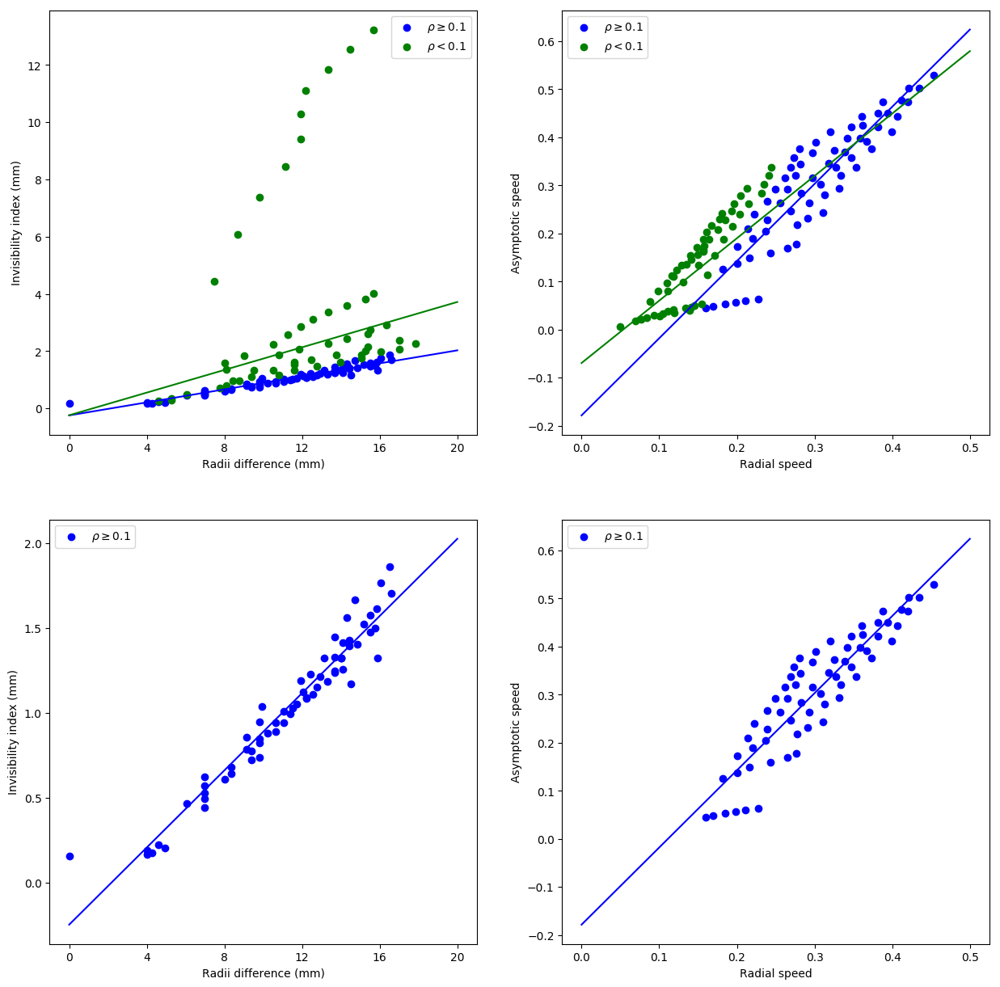

In [123]:
f = plt.figure(figsize=(15,15))
plt.subplot(2,2,1)
plt.scatter(distances_1, lambdas_1, color='blue', label=r'$\rho \geq 0.1$')
plt.scatter(distances_2, lambdas_2, color='green', label=r'$\rho < 0.1$')
plt.xlabel('Radii difference (mm)')
plt.ylabel('Invisibility index (mm)')
plt.plot(np.linspace(0, 10, 10), [linreg_d_1.slope * x + linreg_d_1.intercept for x in np.linspace(0, 10, 10)], 'blue')
plt.plot(np.linspace(0, 10, 10), [linreg_d_g.slope * x + linreg_d_g.intercept for x in np.linspace(0, 10, 10)], 'green')
plt.legend()
plt.subplot(2,2,2)
plt.scatter(vitesses_1, vitesses_theoriques_1, color='blue', label=r'$\rho \geq 0.1$')
plt.scatter(vitesses_2, vitesses_theoriques_2, color='green', label=r'$\rho < 0.1$')
plt.plot(np.linspace(0, 0.5, 10), [linreg_v_1.slope * x + linreg_v_1.intercept for x in np.linspace(0, 0.5, 10)], 'blue')
plt.plot(np.linspace(0, 0.5, 10), [linreg_v_g.slope * x + linreg_v_g.intercept for x in np.linspace(0, 0.5, 10)], 'green')
plt.xlabel('Radial speed')
plt.ylabel('Asymptotic speed')
plt.legend()
plt.subplot(2,2,3)
plt.scatter(distances_1, lambdas_1, color='blue', label=r'$\rho \geq 0.1$')
plt.plot(np.linspace(0, 10, 10), [linreg_d_1.slope * x + linreg_d_1.intercept for x in np.linspace(0, 10, 10)], 'blue')
plt.xlabel('Radii difference (mm)')
plt.ylabel('Invisibility index (mm)')
plt.legend()
plt.subplot(2,2,4)
plt.scatter(vitesses_1, vitesses_theoriques_1, color='blue', label=r'$\rho \geq 0.1$')
plt.plot(np.linspace(0, 0.5, 10), [linreg_v_1.slope * x + linreg_v_1.intercept for x in np.linspace(0, 0.5, 10)], 'blue')
plt.xlabel('Radial speed')
plt.ylabel('Asymptotic speed')
plt.legend()
plt.show()
f.savefig('regression.jpg', dpi=200)

Print slope and intercept.

In [26]:
print(linreg_d_1.slope/2, linreg_d_1.intercept)
print(linreg_d_g.slope/2, linreg_d_g.intercept)
print(linreg_v_1.slope, linreg_v_1.intercept)
print(linreg_v_g.slope, linreg_v_g.intercept)

0.11366649580773482 -0.24789176360460385
0.19799742783716323 -0.24331958766027872
1.6053745263583057 -0.17848835482393682
1.2977359594599653 -0.06949690707293313


Plot 1D densities.

In [0]:
def print_density(t, i=-1, axisoff=True):
  x = np.linspace(0, 100, 101)
  D, rho = np.sqrt(float(Ds[i])), float(rhos[i])
  y = Us[i][t, 50, :]
  plt.plot(x, y, color='black')
  plt.hlines(y.max() * 0.8, xmin=0, xmax=101, color='red', linestyles='dashed', label=r'$\tau_1=0.8$')
  plt.hlines(y.max() * 0.16, xmin=0, xmax=101, color='blue', linestyles='dashed', label=r'$\tau_2=0.16$')
  plt.ylabel(r'Density $u$')
  plt.grid(False)
  if axisoff:
    plt.axis('off')
    plt.title('t={:1.1f} days'.format(t*0.1))
  else:
    plt.axis('off')
    leg = plt.legend(loc='upper right')
    leg.get_frame().set_linewidth(0.0)
    plt.title(r'$D={0:1.2f} \, \, , \, \, \rho={1:0.2f}$ , t={2:1.1f} days'.format(D, rho, t*0.1))

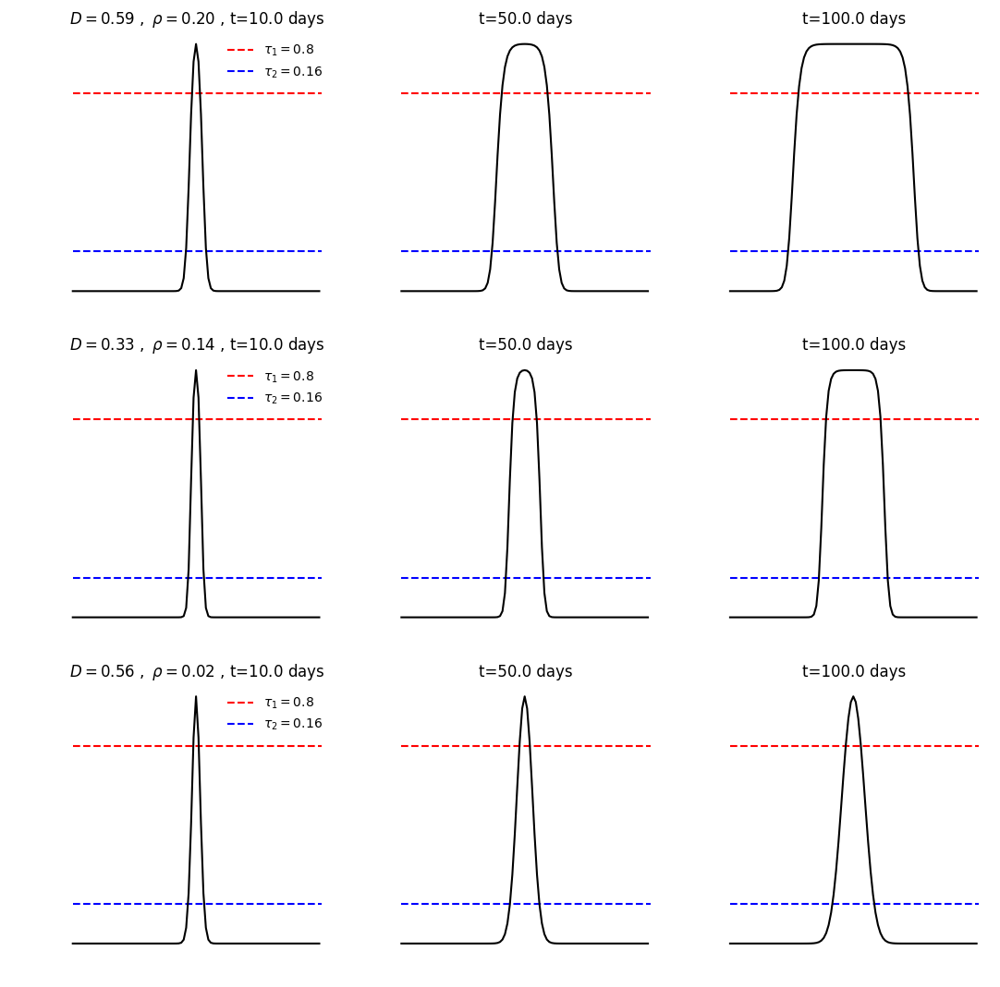

In [119]:
plt.figure(figsize=(13, 13))
plt.subplot(3, 3, 1)
print_density(100, axisoff=False)
plt.subplot(3, 3, 2)
print_density(500)
plt.subplot(3, 3, 3)
print_density(1000)
plt.subplot(3, 3, 4)
print_density(100, 80, axisoff=False)
plt.subplot(3, 3, 5)
print_density(500, 80)
plt.subplot(3, 3, 6)
print_density(1000, 80)
plt.subplot(3, 3, 7)
print_density(100, 20, axisoff=False)
plt.subplot(3, 3, 8)
print_density(500, 20)
plt.subplot(3, 3, 9)
print_density(1000, 20)
plt.savefig('density.jpg', dpi=200)

Plot tumors on 2D grid.

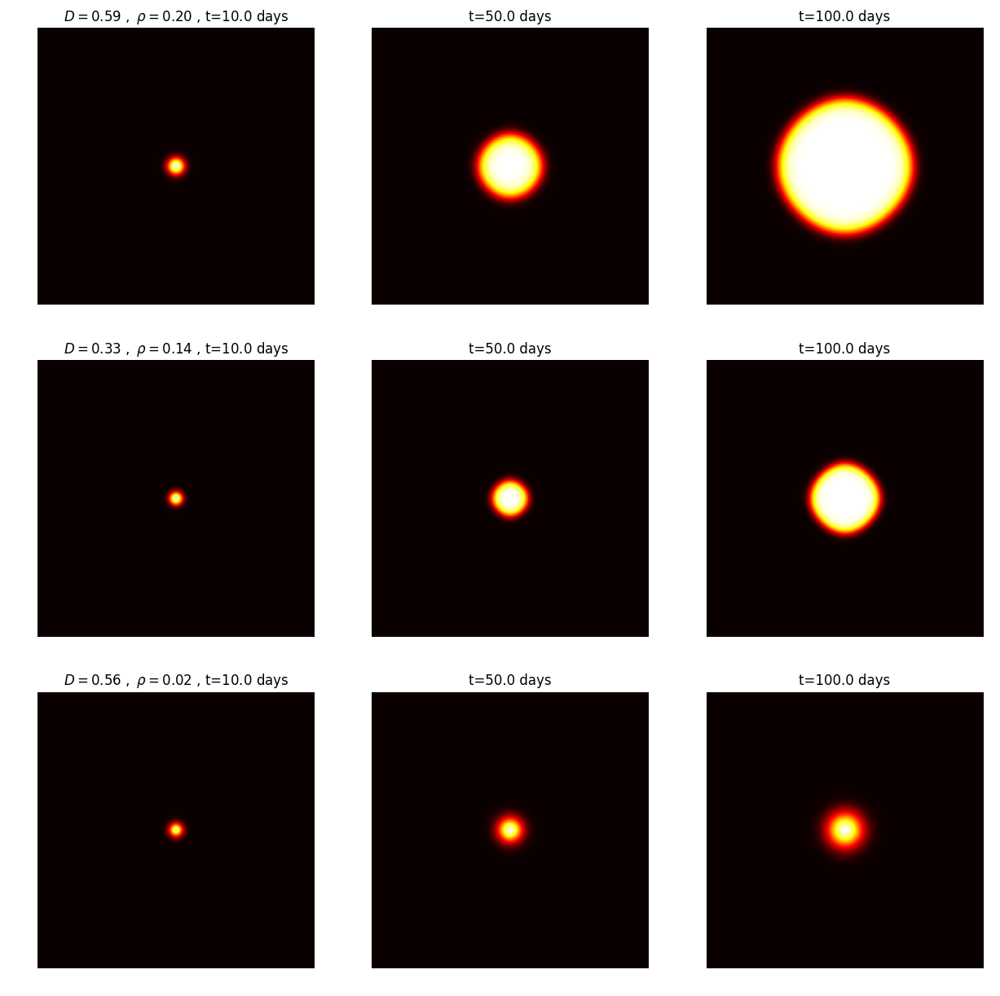

In [121]:
def viz(i, t):
    plt.imshow(Us[i][t], interpolation='gaussian', cmap=cm.hot)
    plt.title(r'$D={0:1.2f} \, \, , \, \, \rho={1:0.2f}$ , t={2:1.1f} days'.format(self.D, self.rho, t*self.dt))
    plt.grid(False)
    plt.axis('off')
        

f, ax = plt.subplots(3, 3, figsize=(15,15))


i, t = -1, 100
D, rho = np.sqrt(float(Ds[i])), float(rhos[i])
ax[0, 0].imshow(Us[i][t], interpolation='gaussian', cmap=cm.hot)
ax[0, 0].set_title(r'$D={0:1.2f} \, \, , \, \, \rho={1:0.2f}$ , t={2:3.1f} days'.format(D, rho, t*0.1))
ax[0, 0].grid(False)
ax[0, 0].axis('off')

i, t = -1, 500
D, rho = np.sqrt(float(Ds[i])), float(rhos[i])
ax[0, 1].imshow(Us[i][t], interpolation='gaussian', cmap=cm.hot)
ax[0, 1].set_title(r't={:3.1f} days'.format(t*0.1))
ax[0, 1].grid(False)
ax[0, 1].axis('off')

i, t = -1, 1000
D, rho = np.sqrt(float(Ds[i])), float(rhos[i])
ax[0, 2].imshow(Us[i][t], interpolation='gaussian', cmap=cm.hot)
ax[0, 2].set_title(r't={:3.1f} days'.format(t*0.1))
ax[0, 2].grid(False)
ax[0, 2].axis('off')
            
  
###

i, t = 80, 100
D, rho = np.sqrt(float(Ds[i])), float(rhos[i])
ax[1, 0].imshow(Us[i][t], interpolation='gaussian', cmap=cm.hot)
ax[1, 0].set_title(r'$D={0:1.2f} \, \, , \, \, \rho={1:0.2f}$ , t={2:3.1f} days'.format(D, rho, t*0.1))
ax[1, 0].grid(False)
ax[1, 0].axis('off')

i, t = 80, 500
D, rho = np.sqrt(float(Ds[i])), float(rhos[i])
ax[1, 1].imshow(Us[i][t], interpolation='gaussian', cmap=cm.hot)
ax[1, 1].set_title(r't={:3.1f} days'.format(t*0.1))
ax[1, 1].grid(False)
ax[1, 1].axis('off')

i, t = 80, 1000
D, rho = np.sqrt(float(Ds[i])), float(rhos[i])
ax[1, 2].imshow(Us[i][t], interpolation='gaussian', cmap=cm.hot)
ax[1, 2].set_title(r't={:3.1f} days'.format(t*0.1))
ax[1, 2].grid(False)
ax[1, 2].axis('off')


###

i, t = 20, 100
D, rho = np.sqrt(float(Ds[i])), float(rhos[i])
ax[2, 0].imshow(Us[i][t], interpolation='gaussian', cmap=cm.hot)
ax[2, 0].set_title(r'$D={0:1.2f} \, \, , \, \, \rho={1:0.2f}$ , t={2:3.1f} days'.format(D, rho, t*0.1))
ax[2, 0].grid(False)
ax[2, 0].axis('off')

i, t = 20, 500
D, rho = np.sqrt(float(Ds[i])), float(rhos[i])
ax[2, 1].imshow(Us[i][t], interpolation='gaussian', cmap=cm.hot)
ax[2, 1].set_title(r't={:3.1f} days'.format(t*0.1))
ax[2, 1].grid(False)
ax[2, 1].axis('off')

i, t = 20, 1000
D, rho = np.sqrt(float(Ds[i])), float(rhos[i])
ax[2, 2].imshow(Us[i][t], interpolation='gaussian', cmap=cm.hot)
ax[2, 2].set_title(r't={:3.1f} days'.format(t*0.1))
ax[2, 2].grid(False)
ax[2, 2].axis('off')

f.savefig('imshows.jpg', dpi=300)

## Crank-Nicholson scheme on MNI IRM (2D)

In [0]:
class CNicholsonIRM():
    def __init__(self, d_w=0.1, x0 = [95, 127], rho=0.18, dt=0.1, T=10, sigma=1e-3, theta=0.5):
      self.IRM = IRM_b[100]
      self.x0 = x0
      self.i_csf, self.j_csf = np.where(self.IRM == 0)
      self.i_w, self.j_w = np.where(self.IRM == 1)
      self.i_g, self.j_g = np.where(self.IRM == 0.5)
      self.D_w = d_w
      self.D_g = d_w / 10
      self.rho = rho
      self.Lx, self.Ly = self.IRM.shape
      self.Nx, self.Ny, self.N = self.Lx, self.Ly, (self.Lx)*(self.Ly)
      self.x, self.y,  = np.arange(0, self.Lx), np.arange(0, self.Ly)
      self.dx, self.dy = self.x[1] - self.x[0], self.y[1] - self.y[0]
      self.dt, self.T, self.Nt = dt, T, int(round(T/float(dt)))
      self.t = np.linspace(0, self.Nt*dt, self.Nt+1)
      self.theta = theta
      self.sigma = sigma
      self.Fx_g = self.D_g*self.dt/self.dx**2
      self.Fy_g = self.D_g*dt/self.dy**2
      self.Fx_w = self.D_w*self.dt/self.dx**2
      self.Fy_w = self.D_w*dt/self.dy**2
      self.A = np.empty((self.N, self.N))
      self.b = np.zeros(self.N)
      self.u = self.init()

    def I(self, x, y):
      l = np.linalg.norm(np.array([x, y])-np.array(self.x0), 2)
      return np.exp(-l**2 / self.sigma)

    def init(self):
      u  = np.empty((self.Nt, self.Nx, self.Ny))
      # Initial condition
      for i in range(self.Nx):
          for j in range(self.Ny):
              u[0, i, j] = self.I(self.x[i], self.y[j])
      return u
              
    def simulation(self):
      m = lambda i, j: i*self.Ny + j
      # Equations corresponding to j=0, i=0,1,...
      for i, j in zip(self.i_csf, self.j_csf):
          p = m(i, j) ; self.A[p, p] = 1
      # Loop over all internal mesh points in y diretion
      # and all mesh points in x direction
      for i, j in zip(self.i_w, self.j_w):
              p = m(i,j)
              self.A[p, m(i,j-1)]  = - self.theta*self.Fy_w
              self.A[p, m(i-1, j)] = - self.theta*self.Fx_w
              self.A[p, p]         = 1 + 2*self.theta*(self.Fx_w+self.Fy_w)
              self.A[p, m(i+1,j)]  = - self.theta*self.Fx_w
              self.A[p, m(i,j+1)]  = - self.theta*self.Fy_w
      for i, j in zip(self.i_g, self.j_g):
              p = m(i,j)
              self.A[p, m(i,j-1)]  = - self.theta*self.Fy_g
              self.A[p, m(i-1, j)] = - self.theta*self.Fx_g
              self.A[p, p]         = 1 + 2*self.theta*(self.Fx_g+self.Fy_g)
              self.A[p, m(i+1,j)]  = - self.theta*self.Fx_g
              self.A[p, m(i,j+1)]  = - self.theta*self.Fy_g
      # Main loop
      for t in range(self.Nt):
          # Compute b
          for i, j in zip(self.i_csf, self.j_csf):
              p = m(i, j) ; self.b[p] = 0
          for i, j in zip(self.i_w, self.j_w):
              p = m(i,j)
              self.b[p] = self.u[t, i, j] + (1-self.theta) * (self.Fx_w*(self.u[t, i+1, j] - 2*self.u[t, i, j] + self.u[t, i-1, j]) +\
                                                              self.Fy_w*(self.u[t, i, j+1] - 2*self.u[t, i, j] + self.u[t, i, j-1])) +\
              self.dt*self.rho*(self.u[t, i, j] * (1 - self.u[t, i, j])) 
          for i, j in zip(self.i_g, self.j_g):
              p = m(i,j)
              self.b[p] = self.u[t, i, j] + (1-self.theta) * (self.Fx_g*(self.u[t, i+1, j] - 2*self.u[t, i, j] + self.u[t, i-1, j]) +\
                                                              self.Fy_g*(self.u[t, i, j+1] - 2*self.u[t, i, j] + self.u[t, i, j-1])) +\
              self.dt*self.rho*(self.u[t, i, j] * (1 - self.u[t, i, j]))
          # Solve matrix system A*c = b
          c = spsolve(self.A, self.b)
          # Fill u with vector c
          for i in range(self.Nx):
              for j in range(self.Ny):
                if t == self.Nt-1:
                  self.u[t, i, j] = c[m(i,j)]
                else:
                  self.u[t+1, i, j] = c[m(i,j)]
          if t % 10 == 0:
            self.viz([t])
            plt.show()
      return self.u

    def viz(self, frames):
      for t in frames: 
        u = self.u[t]
        #mask_tau1 = np.ma.masked_array(u, u < u.max() * 0.8)
        fig, ax = plt.subplots(1, 3, figsize=(18, 18))
        v1b = np.ma.masked_array(u, u<0.01)
        pa = ax[0].imshow(1-img[100, 35:210, 25:170], interpolation='gaussian',cmap=cm.Greys)
        pb = ax[0].imshow(v1b, interpolation='gaussian',cmap=cm.Reds)
        ax[0].set_title(r'$D={0:1.2f} \, \, , \, \, \rho={1:0.2f}$ , t={2:1.1f} days'.format(self.D_w, self.rho, t*self.dt))
        ax[0].grid(False)
        ax[0].axis('off')
        pa = ax[1].imshow(1-self.IRM, interpolation='gaussian',cmap=cm.Greys)
        pb = ax[1].imshow(v1b, interpolation='gaussian',cmap=cm.Reds)
        ax[1].set_title(r'$D={0:1.2f} \, \, , \, \, \rho={1:0.2f}$ , t={2:1.1f} days'.format(self.D_w, self.rho, t*self.dt))
        ax[1].grid(False)
        ax[1].axis('off')
        pa = ax[2].imshow(1-img[100, 35:210, 25:170], interpolation='gaussian',cmap=cm.Greys)
        pc = ax[2].contour(u, levels=[0.16 * u.max(), 0.8 * u.max()], colors=['red', 'orange'], alpha=0.5)
        ax[2].set_title(r'$D={0:1.2f} \, \, , \, \, \rho={1:0.2f}$ , t={2:1.1f} days'.format(self.D_w, self.rho, t*self.dt))
        ax[2].grid(False)
        ax[2].axis('off')
        fig.savefig('/content/gdrive/My Drive/MEDICAL_IMAGE_ANALYSIS/CN_IRM_D{}_rho_{}_t{}days.jpg'.format(self.D_w, self.rho, t*self.dt), dpi=400)
      

Run simulation 1.

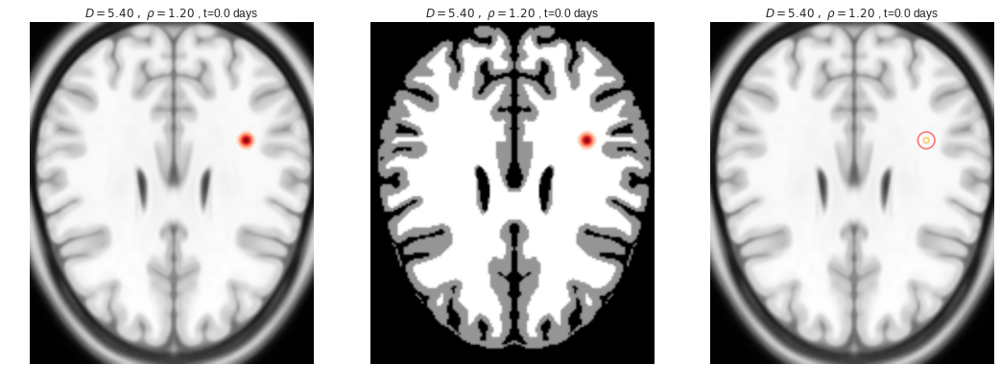

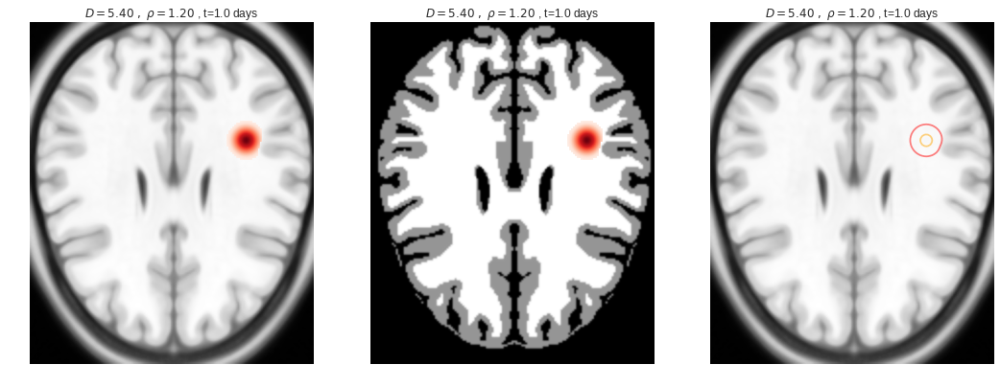

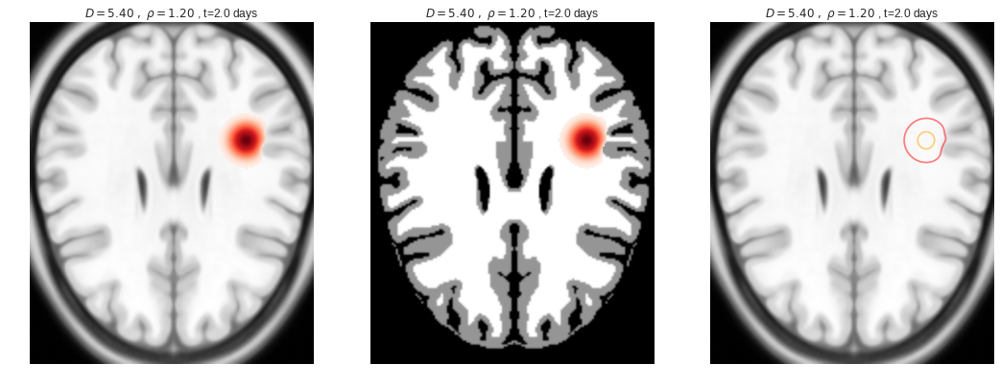

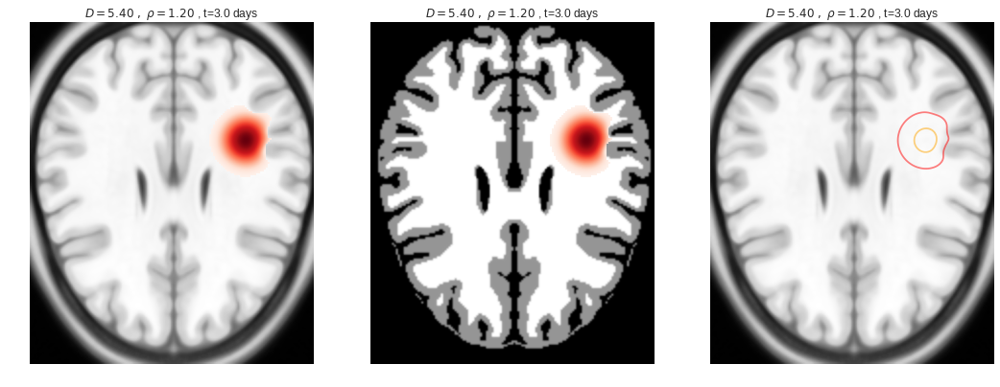

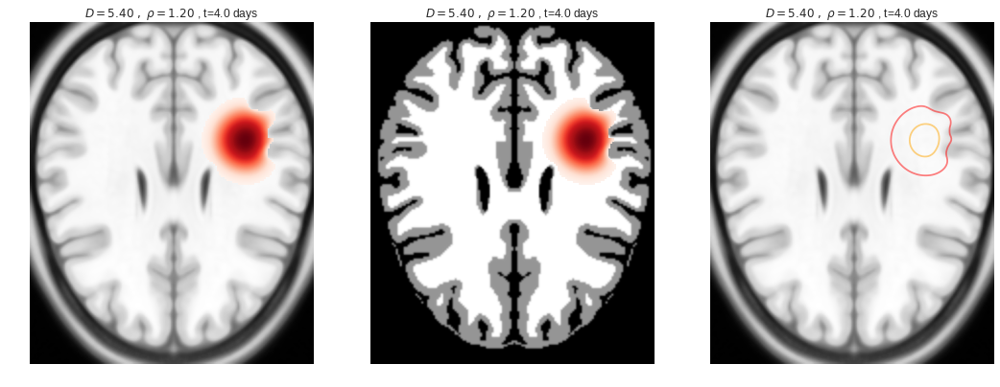

...

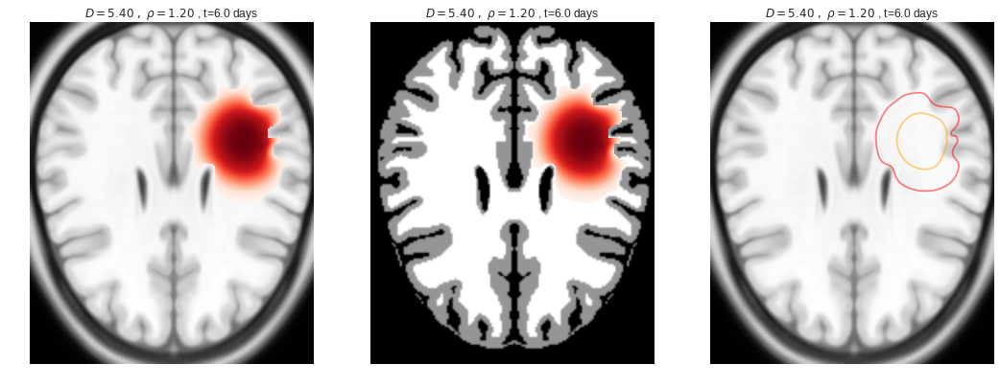

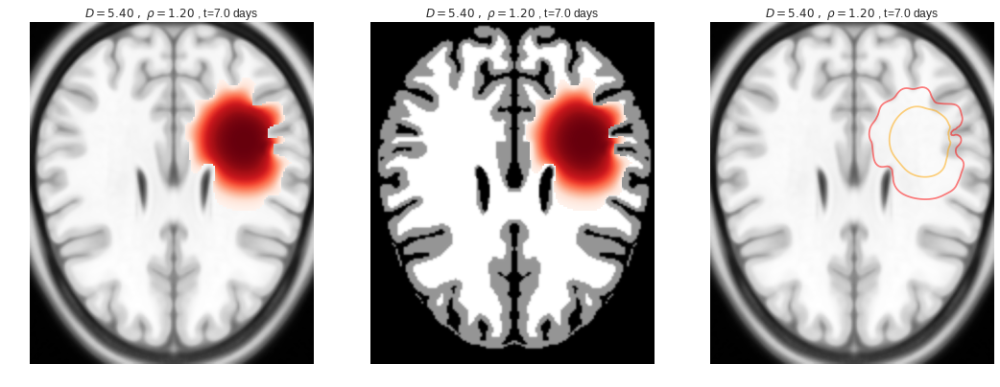

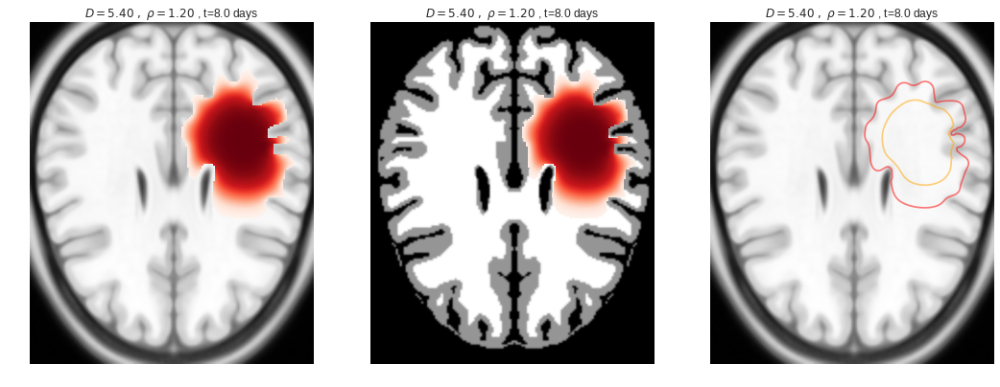

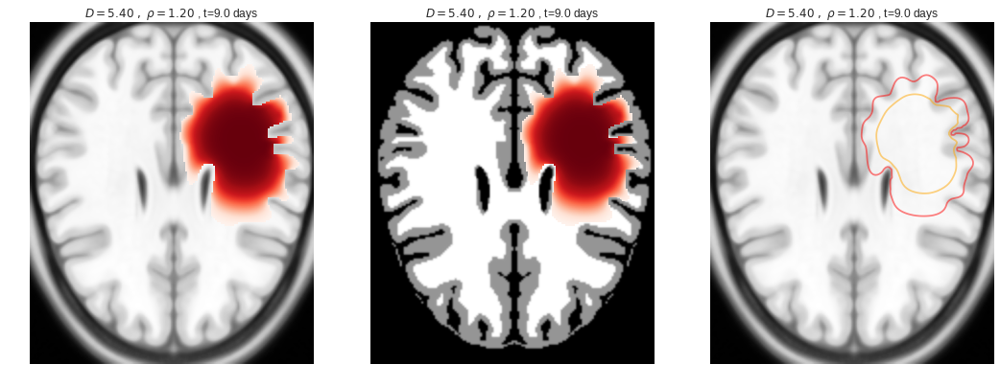

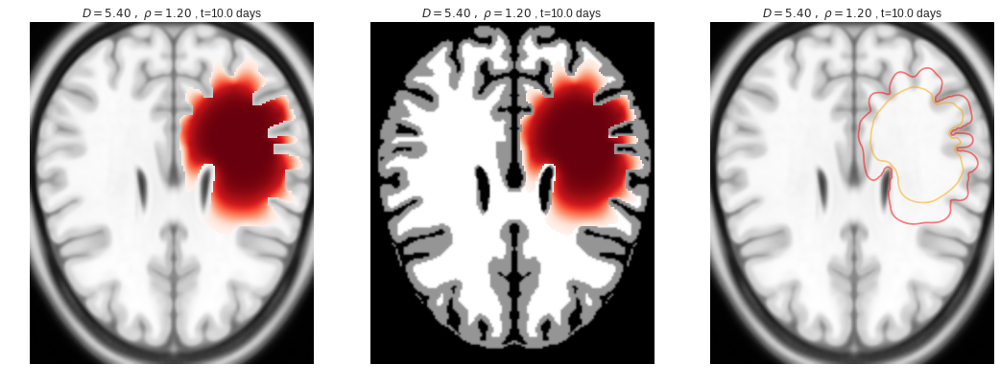

array([[[0.00000000e+000, 0.00000000e+000, 0.00000000e+000, ...,
         1.52135851e-201, 2.28727001e-204, 2.81542788e-207],
        [0.00000000e+000, 0.00000000e+000, 0.00000000e+000, ...,
         2.24045333e-196, 3.36838535e-199, 4.14618562e-202],
        [0.00000000e+000, 0.00000000e+000, 0.00000000e+000, ...,
         2.70135301e-191, 4.06131999e-194, 4.99912711e-197],
        ...,
        [0.00000000e+000, 0.00000000e+000, 0.00000000e+000, ...,
         0.00000000e+000, 0.00000000e+000, 0.00000000e+000],
        [0.00000000e+000, 0.00000000e+000, 0.00000000e+000, ...,
         0.00000000e+000, 0.00000000e+000, 0.00000000e+000],
        [0.00000000e+000, 0.00000000e+000, 0.00000000e+000, ...,
         0.00000000e+000, 0.00000000e+000, 0.00000000e+000]],

       [[0.00000000e+000, 0.00000000e+000, 0.00000000e+000, ...,
         0.00000000e+000, 0.00000000e+000, 0.00000000e+000],
        [0.00000000e+000, 0.00000000e+000, 0.00000000e+000, ...,
         0.00000000e+000, 0.00000000e+

In [11]:
IRM_r = normalize_IRM(img)
IRM_b = IRM_r[:, 35:210, 25:170]
warnings.filterwarnings('ignore')
cnIRM = CNicholsonIRM(d_w=5.4, x0 = [60, 110], rho=1.2, sigma=10, T=10.1)  # [95, 135]
cnIRM.simulation()

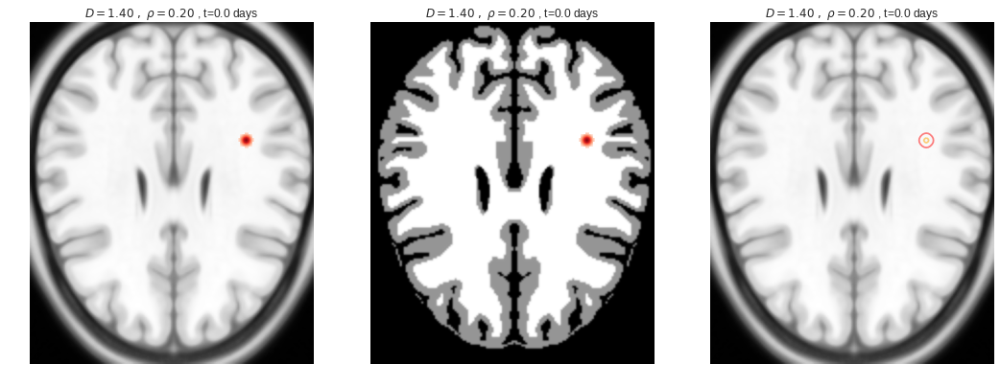

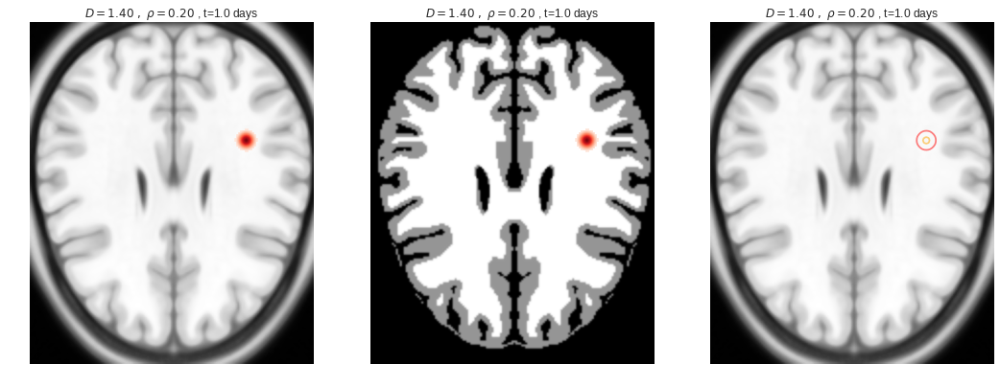

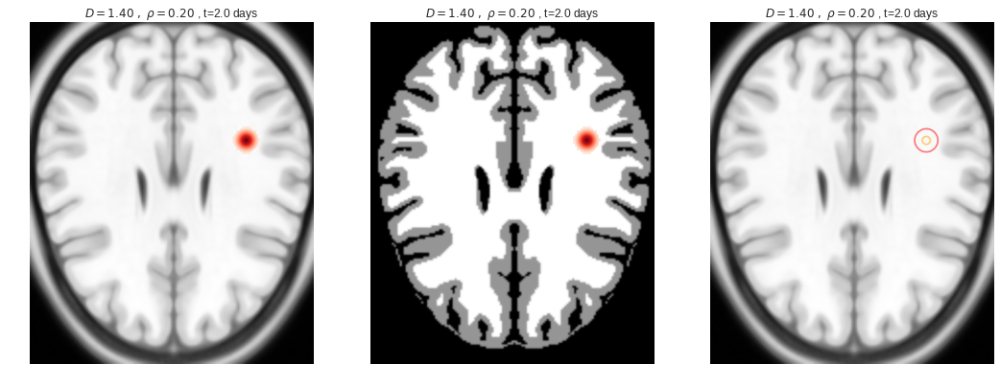

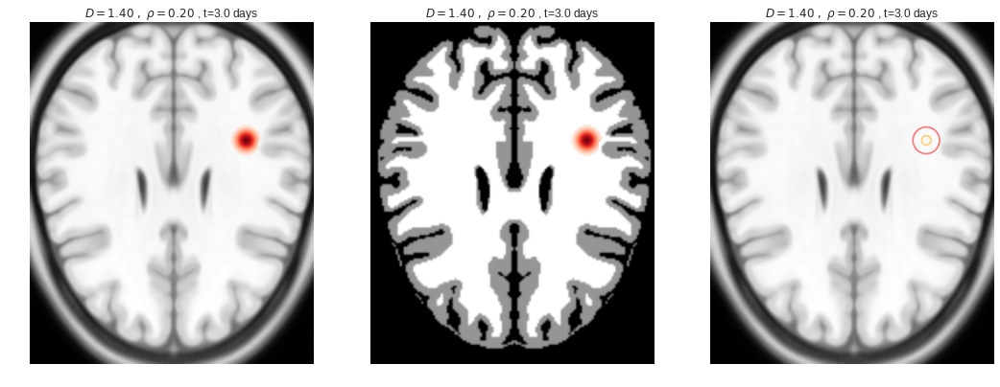

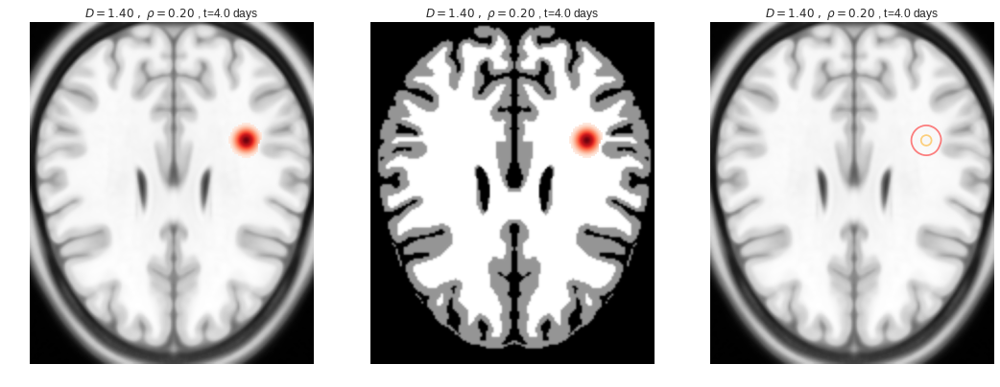

...

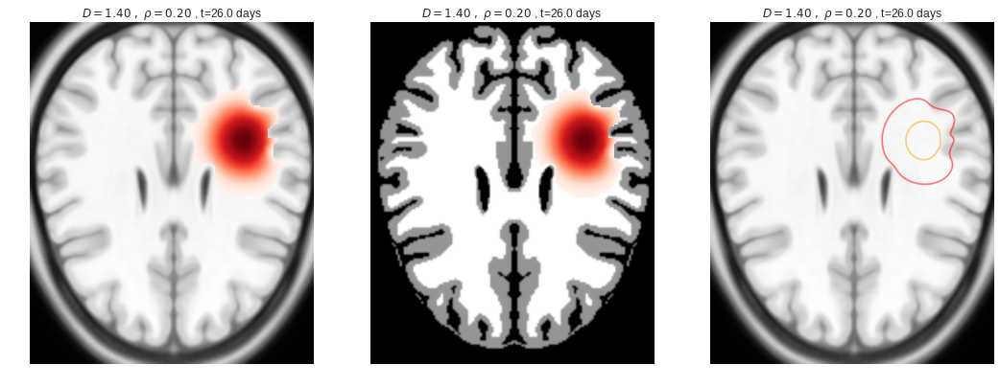

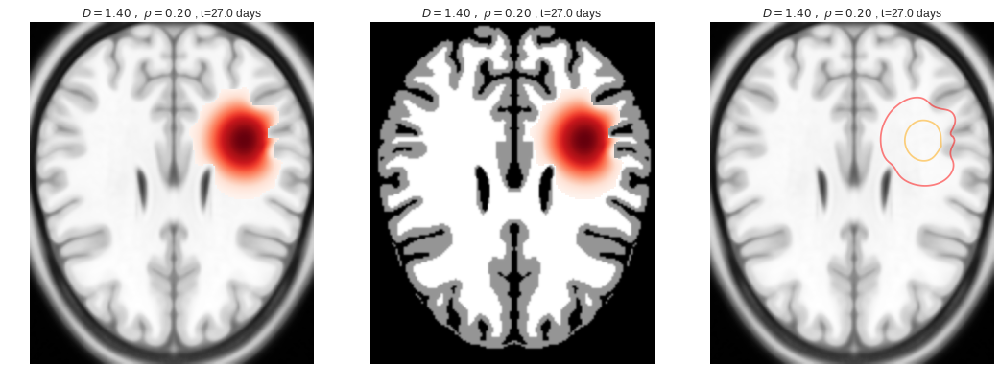

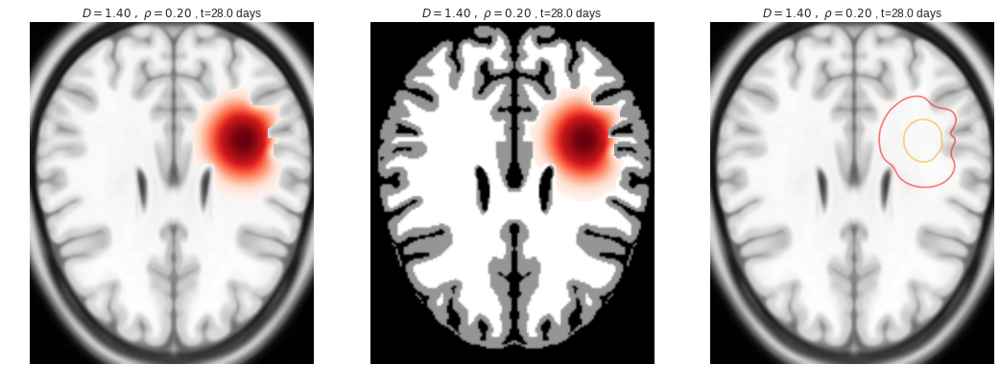

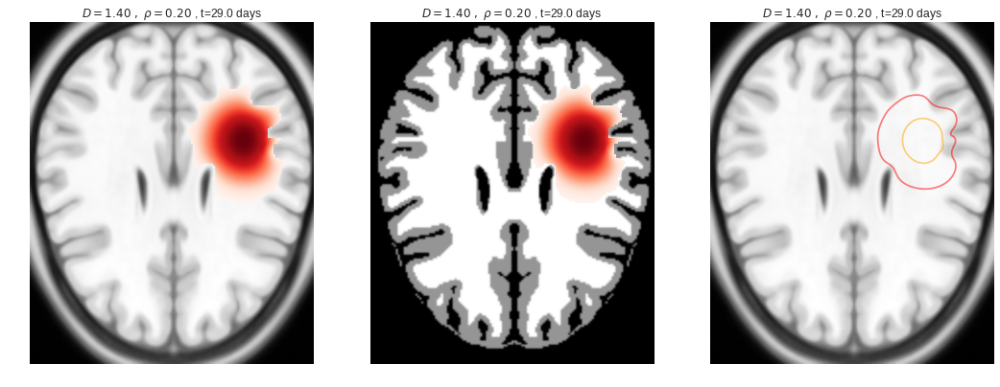

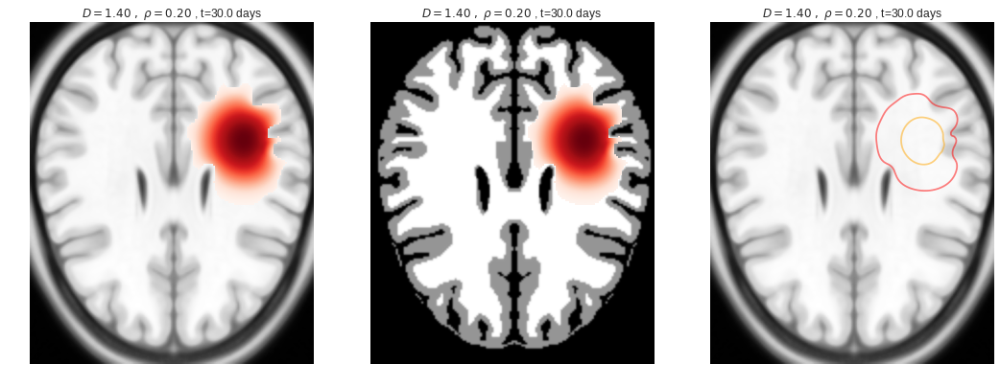

array([[[0.00000000e+000, 0.00000000e+000, 0.00000000e+000, ...,
         1.31061058e-287, 1.21545587e-291, 8.47072497e-296],
        [0.00000000e+000, 0.00000000e+000, 0.00000000e+000, ...,
         3.16577366e-280, 2.93592790e-284, 2.04609961e-288],
        [0.00000000e+000, 0.00000000e+000, 0.00000000e+000, ...,
         5.74648021e-273, 5.32926653e-277, 3.71405925e-281],
        ...,
        [0.00000000e+000, 0.00000000e+000, 0.00000000e+000, ...,
         0.00000000e+000, 0.00000000e+000, 0.00000000e+000],
        [0.00000000e+000, 0.00000000e+000, 0.00000000e+000, ...,
         0.00000000e+000, 0.00000000e+000, 0.00000000e+000],
        [0.00000000e+000, 0.00000000e+000, 0.00000000e+000, ...,
         0.00000000e+000, 0.00000000e+000, 0.00000000e+000]],

       [[0.00000000e+000, 0.00000000e+000, 0.00000000e+000, ...,
         0.00000000e+000, 0.00000000e+000, 0.00000000e+000],
        [0.00000000e+000, 0.00000000e+000, 0.00000000e+000, ...,
         0.00000000e+000, 0.00000000e+

In [3]:
IRM_r = normalize_IRM(img)
IRM_b = IRM_r[:, 35:210, 25:170]
warnings.filterwarnings('ignore')
cnIRM = CNicholsonIRM(d_w=1.4, x0 = [60, 110], rho=0.2, sigma=7, T=30.1)  # [95, 135]
cnIRM.simulation()

Run simulation 2.

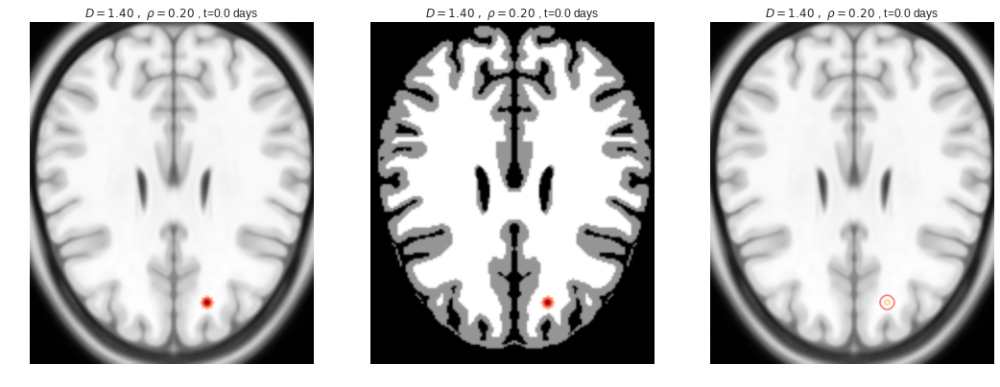

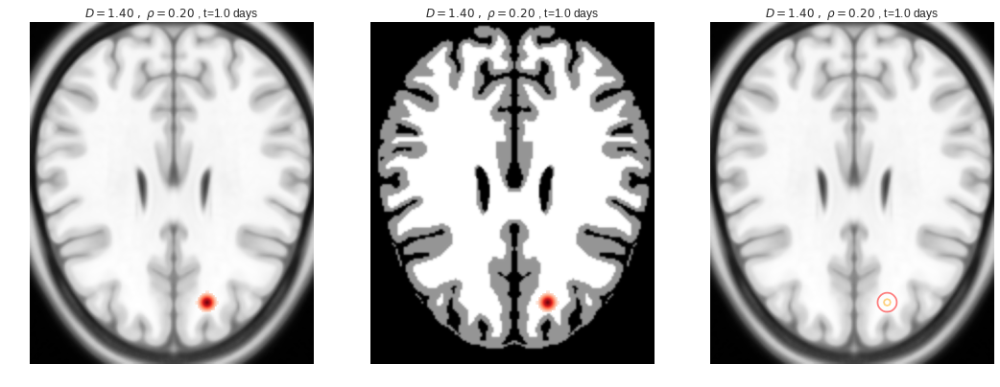

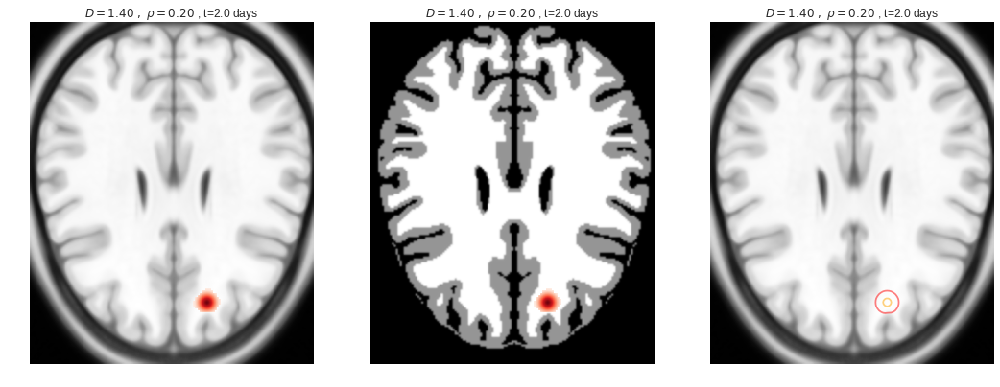

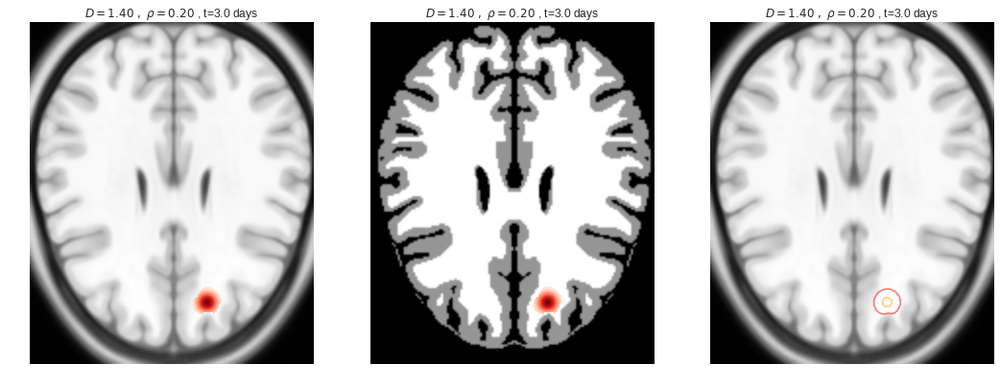

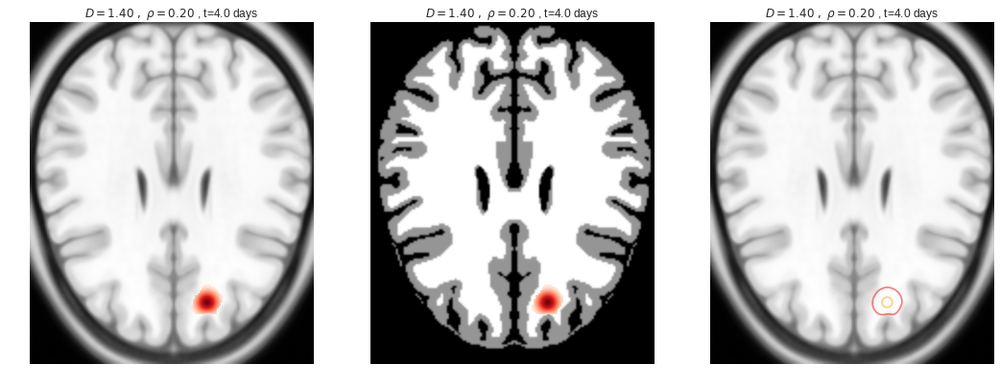

...

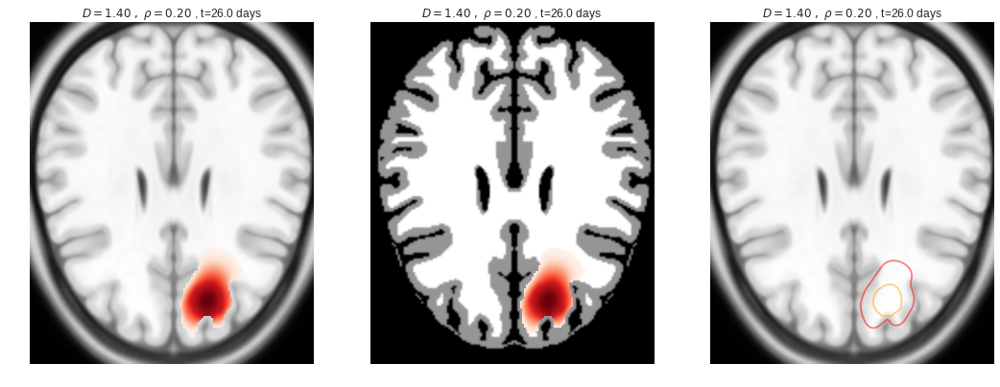

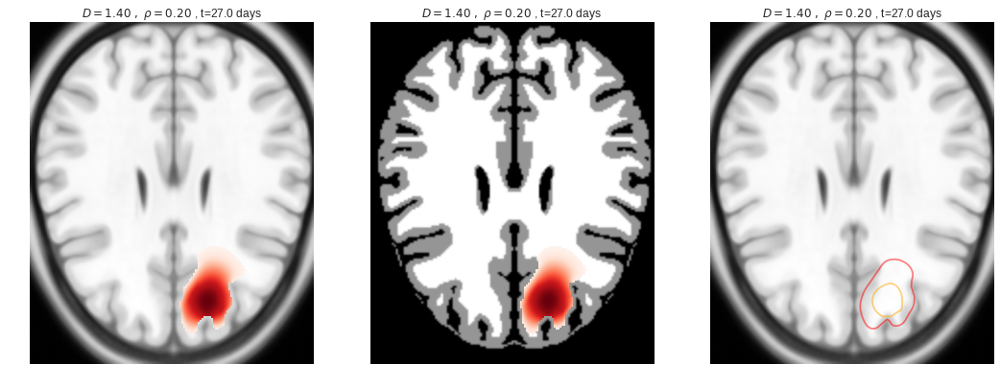

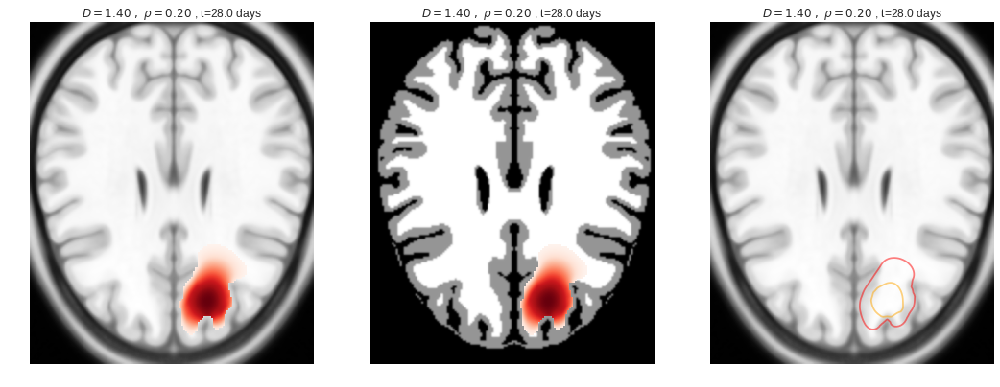

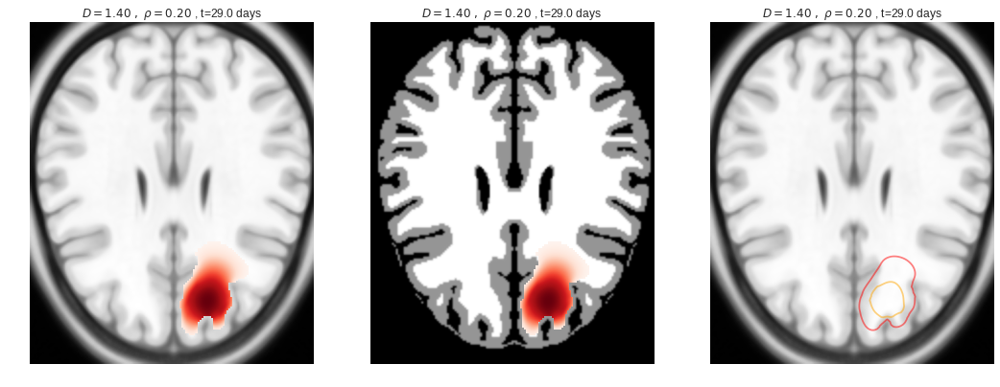

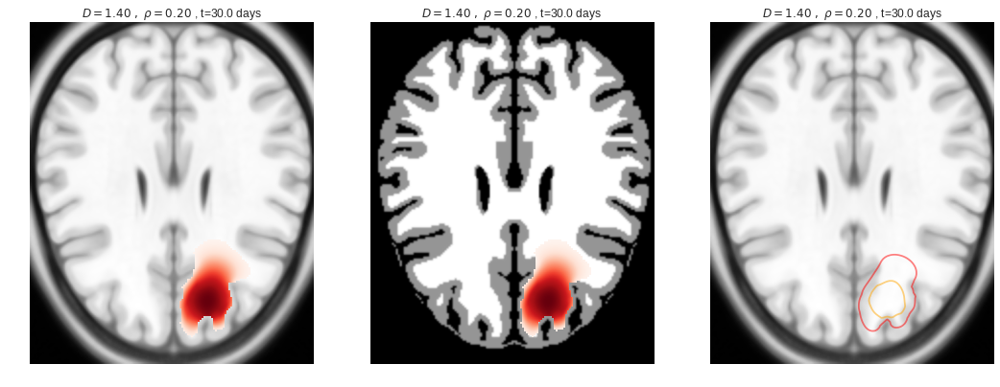

array([[[0.00000000e+000, 0.00000000e+000, 0.00000000e+000, ...,
         0.00000000e+000, 0.00000000e+000, 0.00000000e+000],
        [0.00000000e+000, 0.00000000e+000, 0.00000000e+000, ...,
         0.00000000e+000, 0.00000000e+000, 0.00000000e+000],
        [0.00000000e+000, 0.00000000e+000, 0.00000000e+000, ...,
         0.00000000e+000, 0.00000000e+000, 0.00000000e+000],
        ...,
        [0.00000000e+000, 0.00000000e+000, 0.00000000e+000, ...,
         1.15044524e-220, 3.51923868e-227, 8.08997828e-234],
        [0.00000000e+000, 0.00000000e+000, 0.00000000e+000, ...,
         2.51410776e-224, 7.69071398e-231, 1.76793093e-237],
        [0.00000000e+000, 0.00000000e+000, 0.00000000e+000, ...,
         4.12874147e-228, 1.26299160e-234, 2.90334800e-241]],

       [[0.00000000e+000, 0.00000000e+000, 0.00000000e+000, ...,
         0.00000000e+000, 0.00000000e+000, 0.00000000e+000],
        [0.00000000e+000, 0.00000000e+000, 0.00000000e+000, ...,
         0.00000000e+000, 0.00000000e+

In [3]:
IRM_r = normalize_IRM(img)
IRM_b = IRM_r[:, 35:210, 25:170]
warnings.filterwarnings('ignore')
cnIRM = CNicholsonIRM(d_w=1.4, x0 = [143, 90], rho=0.2, sigma=7, T=30.1)  # [95, 135]
cnIRM.simulation()

Run simulation 3.

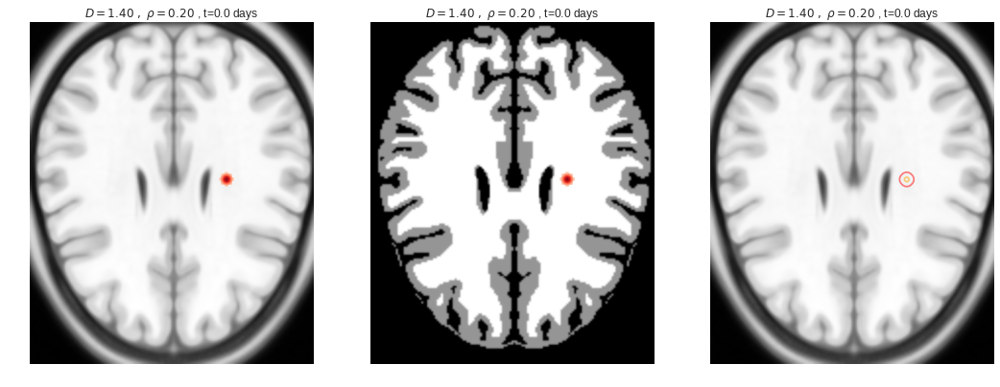

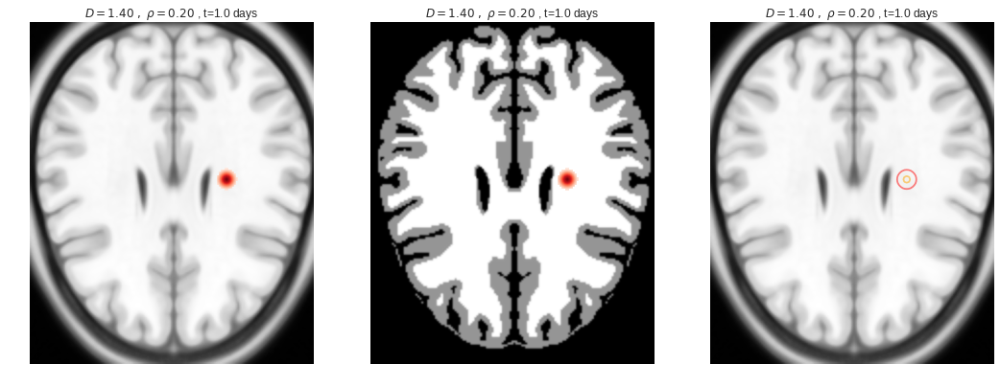

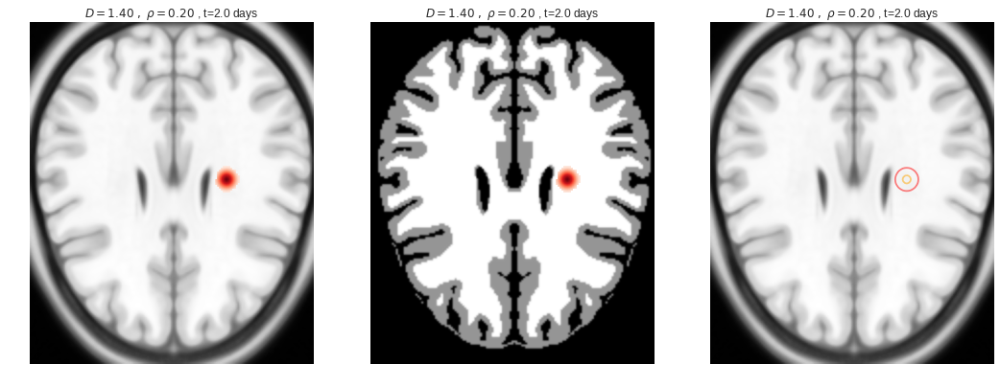

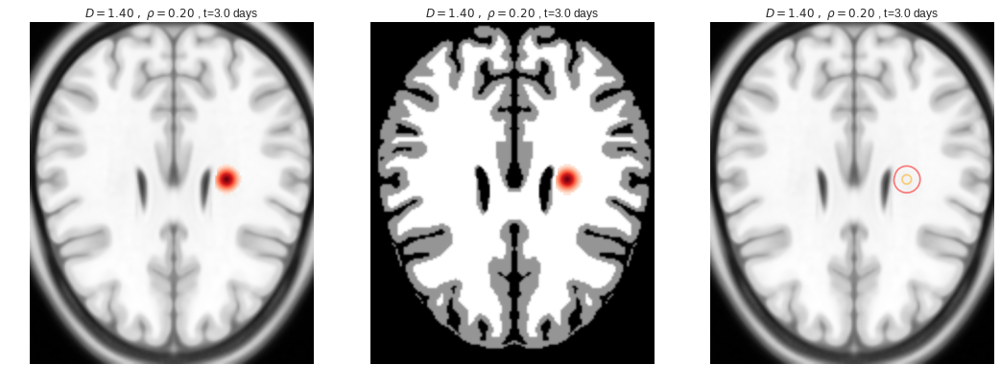

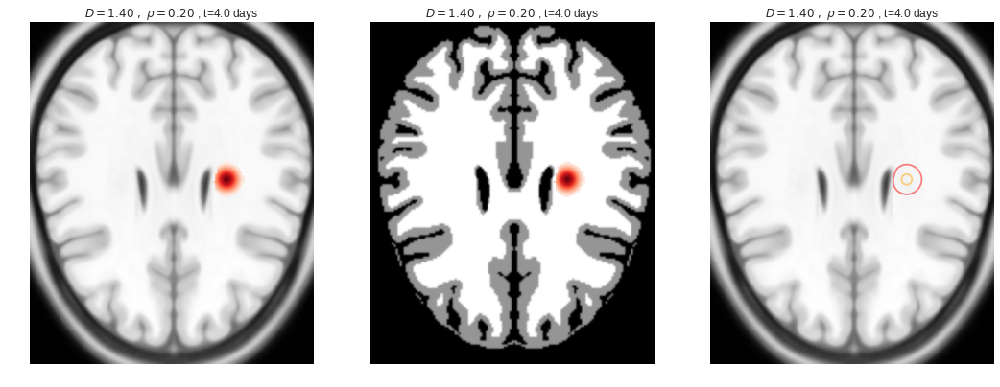

...

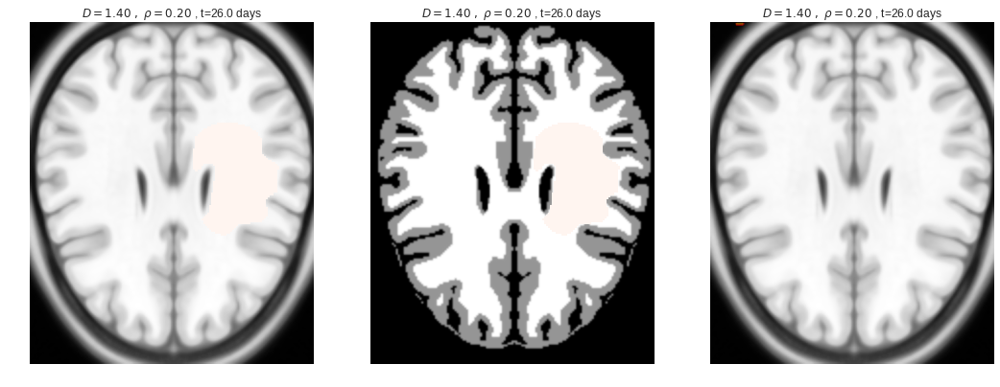

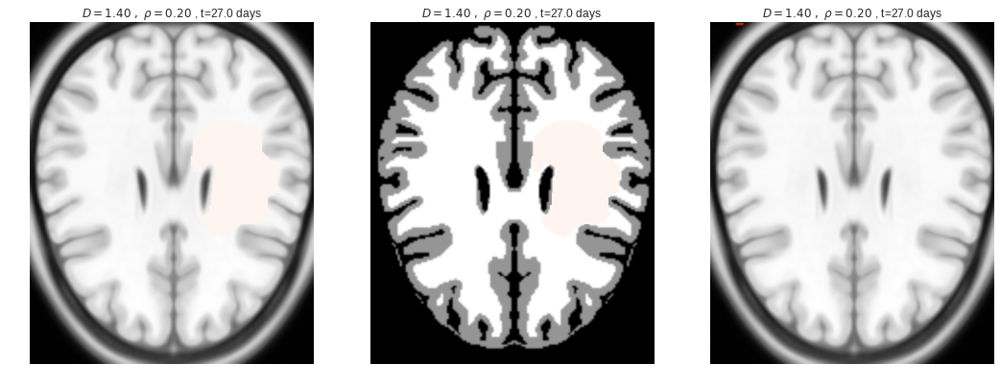

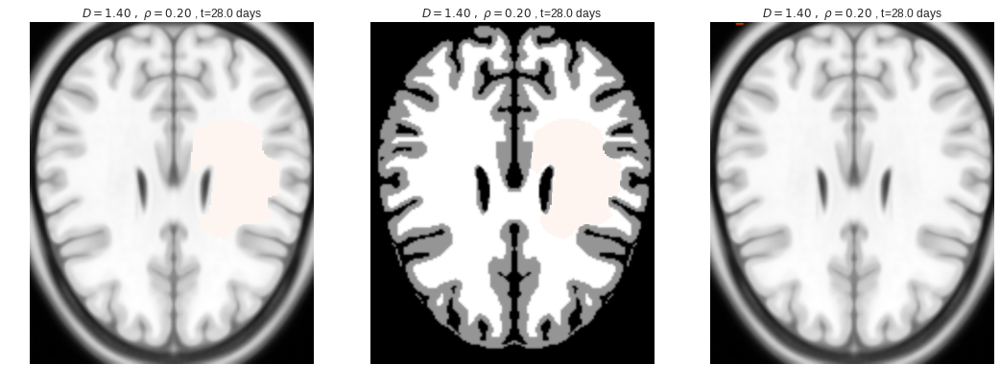

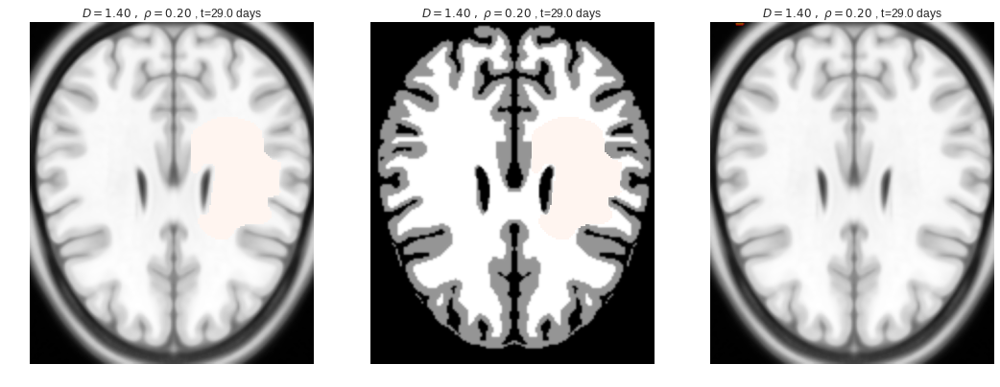

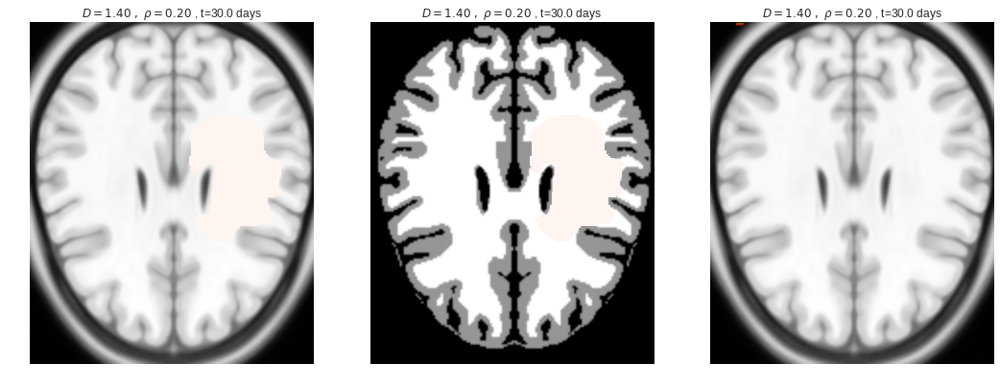

KeyboardInterrupt: ignored

In [6]:
IRM_r = normalize_IRM(img)
IRM_b = IRM_r[:, 35:210, 25:170]
warnings.filterwarnings('ignore')
cnIRM = CNicholsonIRM(d_w=1.4, x0 = [80, 100], rho=0.2, sigma=7, T=100.1)  # [95, 135]
cnIRM.simulation()